# HVAC Plant Operations Analysis
## Hot Water, Chilled Water and Domestic Hot Water Plant Operations

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats
import re
from datetime import datetime, timedelta
import warnings

# Suppress warnings
warnings.filterwarnings('ignore')

# Set better visualization defaults
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_context("notebook", font_scale=1.1)
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 100

# Enable interactive plotly figures in the notebook
import plotly.io as pio
pio.renderers.default = "notebook"

## 1. Data Loading and Initial Preprocessing
Loading the CSV data and performing initial preprocessing steps.

In [7]:
# Read the data
data_path = 'data/chapter7'
df = pd.read_csv(data_path + '/x1-plant-20250407-20250414.csv')

# Display basic information
print(f"Dataset shape: {df.shape}")
print(f"Number of records: {df.shape[0]}")
print(f"Number of features: {df.shape[1]}")

# Show the first few rows
df.head()

Dataset shape: (10000, 26)
Number of records: 10000
Number of features: 26


,Timestamp,1A-HVP-CHW_FM_m13c7,1A-HVP-CHW_P-VFD-SPD-COMMAND_m3c12,1A-HVP-CHW_SupplyTemp_m13c5,1A-HVP-HW_FM_m13c2,1A-HVP-HW_MV-POSN_m14c0,1A-HVP-HW_P-VFD-SPD-COMMAND_m3c11,1A-HVP-HW_ReturnTemp_m13c1,1-PLT-HW_ReturnTemp_m4c1,1A-HVP-CHW_MV-POSN_m14c1,...,1B-HVP-CHW_SupplyTemp_m13c5,1B-HVP-HW_FM_m13c2,1B-HVP-HW_MV-POSN_m14c0,1B-HVP-HW_P-VFD-SPD-COMMAND_m3c11,1B-HVP-HW_ReturnTemp_m13c1,1B-HVP-HW_SupplyTemp_m13c0,1-PLT-CHW_FM_m5c4,1-PLT-CHW_ReturnTemp_m5c1,1-PLT-CHW_SupplyTemp_m5c0,1-PLT-HW_SupplyTemp_m4c0
0,2025-04-06T23:59:00-08:00 GMT+8,-0.003750,70.0,11.805918,8.635705,74.989067,70,54.160069,57.982452,75.216293,...,10.475084,7.914548,74.408501,70.0,56.044308,59.208015,31.442701,10.697201,10.818849,59.223995
1,2025-04-07T00:00:00-08:00 GMT+8,-0.003838,70.0,11.808234,8.636075,74.995178,70,54.248199,58.051712,75.209885,...,10.475075,7.913702,74.410736,70.0,56.079254,59.214706,31.465260,10.720372,10.842798,59.244759
2,2025-04-07T00:01:00-08:00 GMT+8,-0.003733,70.0,11.812600,8.638296,74.981544,70,54.303020,58.057404,75.196541,...,10.478762,7.914269,74.411751,70.0,56.103672,59.236362,31.461641,10.738330,10.871675,59.228104
3,2025-04-07T00:02:00-08:00 GMT+8,-0.003612,70.0,11.816528,8.638912,75.000549,70,54.290234,58.038849,75.211548,...,10.484300,7.914650,74.416122,70.0,56.126537,59.208504,31.474689,10.766316,10.896990,59.096451
4,2025-04-07T00:03:00-08:00 GMT+8,-0.003703,70.0,11.821356,8.637137,74.992912,70,54.310200,58.038498,75.205727,...,10.492901,7.913052,74.423698,70.0,56.162067,59.101505,31.463257,10.815225,10.933206,59.011921


### 1.1 Data Preprocessing

In [8]:
# Convert timestamp to datetime
df['Timestamp'] = pd.to_datetime(df['Timestamp'].str.replace(' GMT+8', ''))
df.set_index('Timestamp', inplace=True)

# Create a dictionary to map original column names to simplified names
def simplify_column_name(col_name):
    # Extract building (1A, 1B, 1-PLT)
    building_match = re.match(r'(1[A|B]|1-PLT)', col_name)
    building = building_match.group(1) if building_match else ""
    
    # Extract system type (CHW, HW)
    system_match = re.search(r'(CHW|HW)', col_name)
    system = system_match.group(1) if system_match else ""
    
    # Extract measurement type
    if 'FM' in col_name:
        measure = 'FlowRate'
    elif 'VFD' in col_name:
        measure = 'PumpSpeed'
    elif 'MV-POSN' in col_name:
        measure = 'ValvePosition'
    elif 'SupplyTemp' in col_name:
        measure = 'SupplyTemp'
    elif 'ReturnTemp' in col_name:
        measure = 'ReturnTemp'
    else:
        measure = col_name.split('_')[-1]
    
    return f"{building}_{system}_{measure}"

column_mapping = {col: simplify_column_name(col) for col in df.columns}
df.rename(columns=column_mapping, inplace=True)

# Create a dictionary to store the appropriate units for each column
units = {
    # Flow rates
    '1A_CHW_FlowRate': 'L/min',
    '1B_CHW_FlowRate': 'L/min',
    '1A_HW_FlowRate': 'L/min',
    '1B_HW_FlowRate': 'L/min',
    '1-PLT_CHW_FlowRate': 'L/min',
    
    # Temperatures
    '1A_CHW_SupplyTemp': '°C',
    '1A_CHW_ReturnTemp': '°C',
    '1B_CHW_SupplyTemp': '°C',
    '1B_CHW_ReturnTemp': '°C',
    '1A_HW_SupplyTemp': '°C',
    '1A_HW_ReturnTemp': '°C',
    '1B_HW_SupplyTemp': '°C',
    '1B_HW_ReturnTemp': '°C',
    '1-PLT_CHW_SupplyTemp': '°C',
    '1-PLT_CHW_ReturnTemp': '°C',
    '1-PLT_HW_SupplyTemp': '°C',
    '1-PLT_HW_ReturnTemp': '°C',
    
    # Valve positions and pump speeds
    '1A_CHW_ValvePosition': '%',
    '1B_CHW_ValvePosition': '%',
    '1A_HW_ValvePosition': '%',
    '1B_HW_ValvePosition': '%',
    '1A_CHW_PumpSpeed': '%',
    '1B_CHW_PumpSpeed': '%',
    '1A_HW_PumpSpeed': '%',
    '1B_HW_PumpSpeed': '%'
}

# Display the column mapping
print("Column mapping:")
for original, new in column_mapping.items():
    print(f"  {original} -> {new}")

# Display the renamed dataframe
df.head()

Column mapping:
  1A-HVP-CHW_FM_m13c7 -> 1A_CHW_FlowRate
  1A-HVP-CHW_P-VFD-SPD-COMMAND_m3c12 -> 1A_CHW_PumpSpeed
  1A-HVP-CHW_SupplyTemp_m13c5 -> 1A_CHW_SupplyTemp
  1A-HVP-HW_FM_m13c2 -> 1A_HW_FlowRate
  1A-HVP-HW_MV-POSN_m14c0 -> 1A_HW_ValvePosition
  1A-HVP-HW_P-VFD-SPD-COMMAND_m3c11 -> 1A_HW_PumpSpeed
  1A-HVP-HW_ReturnTemp_m13c1 -> 1A_HW_ReturnTemp
  1-PLT-HW_ReturnTemp_m4c1 -> 1-PLT_HW_ReturnTemp
  1A-HVP-CHW_MV-POSN_m14c1 -> 1A_CHW_ValvePosition
  1A-HVP-CHW_ReturnTemp_m13c6 -> 1A_CHW_ReturnTemp
  1A-HVP-HW_SupplyTemp_m13c0 -> 1A_HW_SupplyTemp
  1B-HVP-CHW_FM_m13c7 -> 1B_CHW_FlowRate
  1B-HVP-CHW_MV-POSN_m14c1 -> 1B_CHW_ValvePosition
  1B-HVP-CHW_P-VFD-SPD-COMMAND_m3c12 -> 1B_CHW_PumpSpeed
  1B-HVP-CHW_ReturnTemp_m13c6 -> 1B_CHW_ReturnTemp
  1B-HVP-CHW_SupplyTemp_m13c5 -> 1B_CHW_SupplyTemp
  1B-HVP-HW_FM_m13c2 -> 1B_HW_FlowRate
  1B-HVP-HW_MV-POSN_m14c0 -> 1B_HW_ValvePosition
  1B-HVP-HW_P-VFD-SPD-COMMAND_m3c11 -> 1B_HW_PumpSpeed
  1B-HVP-HW_ReturnTemp_m13c1 -> 1B_HW_ReturnTemp

,1A_CHW_FlowRate,1A_CHW_PumpSpeed,1A_CHW_SupplyTemp,1A_HW_FlowRate,1A_HW_ValvePosition,1A_HW_PumpSpeed,1A_HW_ReturnTemp,1-PLT_HW_ReturnTemp,1A_CHW_ValvePosition,1A_CHW_ReturnTemp,...,1B_CHW_SupplyTemp,1B_HW_FlowRate,1B_HW_ValvePosition,1B_HW_PumpSpeed,1B_HW_ReturnTemp,1B_HW_SupplyTemp,1-PLT_CHW_FlowRate,1-PLT_CHW_ReturnTemp,1-PLT_CHW_SupplyTemp,1-PLT_HW_SupplyTemp
Timestamp,,,,,,,,,,,,,,,,,,,,,
2025-04-06 23:59:00-08:00,-0.003750,70.0,11.805918,8.635705,74.989067,70,54.160069,57.982452,75.216293,13.339764,...,10.475084,7.914548,74.408501,70.0,56.044308,59.208015,31.442701,10.697201,10.818849,59.223995
2025-04-07 00:00:00-08:00,-0.003838,70.0,11.808234,8.636075,74.995178,70,54.248199,58.051712,75.209885,13.339400,...,10.475075,7.913702,74.410736,70.0,56.079254,59.214706,31.465260,10.720372,10.842798,59.244759
2025-04-07 00:01:00-08:00,-0.003733,70.0,11.812600,8.638296,74.981544,70,54.303020,58.057404,75.196541,13.339435,...,10.478762,7.914269,74.411751,70.0,56.103672,59.236362,31.461641,10.738330,10.871675,59.228104
2025-04-07 00:02:00-08:00,-0.003612,70.0,11.816528,8.638912,75.000549,70,54.290234,58.038849,75.211548,13.337449,...,10.484300,7.914650,74.416122,70.0,56.126537,59.208504,31.474689,10.766316,10.896990,59.096451
2025-04-07 00:03:00-08:00,-0.003703,70.0,11.821356,8.637137,74.992912,70,54.310200,58.038498,75.205727,13.337246,...,10.492901,7.913052,74.423698,70.0,56.162067,59.101505,31.463257,10.815225,10.933206,59.011921


### 1.2 Calculate Derived Performance Metrics
Calculate key performance metrics for each system, including:
- Delta T (temperature difference between supply and return)
- Energy transfer rates
- System efficiency

In [9]:
# Calculate delta T for each system
for building in ['1A', '1B', '1-PLT']:
    # Chilled Water Delta T
    if f'{building}_CHW_SupplyTemp' in df.columns and f'{building}_CHW_ReturnTemp' in df.columns:
        df[f'{building}_CHW_DeltaT'] = df[f'{building}_CHW_ReturnTemp'] - df[f'{building}_CHW_SupplyTemp']
    
    # Hot Water Delta T
    if f'{building}_HW_SupplyTemp' in df.columns and f'{building}_HW_ReturnTemp' in df.columns:
        df[f'{building}_HW_DeltaT'] = df[f'{building}_HW_SupplyTemp'] - df[f'{building}_HW_ReturnTemp']

# Calculate energy transfer rates (in kW)
# Specific heat of water: 4.186 kJ/kg·°C
# Density of water: 1 kg/L
# Flow rate is in L/min, so we divide by 60 to get L/s
# Energy (kW) = flow rate (L/s) * specific heat (kJ/kg·°C) * density (kg/L) * delta T (°C)

for building in ['1A', '1B']:
    # CHW Energy Transfer
    if f'{building}_CHW_FlowRate' in df.columns and f'{building}_CHW_DeltaT' in df.columns:
        df[f'{building}_CHW_Energy'] = abs(df[f'{building}_CHW_FlowRate'] / 60 * 4.186 * df[f'{building}_CHW_DeltaT'])
    
    # HW Energy Transfer
    if f'{building}_HW_FlowRate' in df.columns and f'{building}_HW_DeltaT' in df.columns:
        df[f'{building}_HW_Energy'] = abs(df[f'{building}_HW_FlowRate'] / 60 * 4.186 * df[f'{building}_HW_DeltaT'])

# Calculate plant energy transfer
if '1-PLT_CHW_FlowRate' in df.columns and '1-PLT_CHW_DeltaT' in df.columns:
    df['1-PLT_CHW_Energy'] = abs(df['1-PLT_CHW_FlowRate'] / 60 * 4.186 * df['1-PLT_CHW_DeltaT'])

# Calculate system efficiency (as a ratio of energy delivered to energy produced)
# For chilled water
total_chw_delivered = df.get('1A_CHW_Energy', 0) + df.get('1B_CHW_Energy', 0)
if '1-PLT_CHW_Energy' in df.columns and df['1-PLT_CHW_Energy'].mean() != 0:
    df['CHW_Distribution_Efficiency'] = (total_chw_delivered / df['1-PLT_CHW_Energy']).replace([np.inf, -np.inf, np.nan], 0)

# Display the derived metrics
print("\nDerived performance metrics:")
derived_metrics = [col for col in df.columns if 'Delta' in col or 'Energy' in col or 'Efficiency' in col]
df[derived_metrics].head()


Derived performance metrics:


,1A_CHW_DeltaT,1A_HW_DeltaT,1B_CHW_DeltaT,1B_HW_DeltaT,1-PLT_CHW_DeltaT,1-PLT_HW_DeltaT,1A_CHW_Energy,1A_HW_Energy,1B_CHW_Energy,1B_HW_Energy,1-PLT_CHW_Energy,CHW_Distribution_Efficiency
Timestamp,,,,,,,,,,,,
2025-04-06 23:59:00-08:00,1.533846,2.392223,0.743413,3.163708,-0.121648,1.241543,0.000401,1.441277,0.000242,1.746910,0.266853,0.002410
2025-04-07 00:00:00-08:00,1.531166,2.339504,0.742417,3.135452,-0.122426,1.193047,0.000410,1.409575,0.000150,1.731123,0.268753,0.002084
2025-04-07 00:01:00-08:00,1.526834,2.317551,0.740699,3.132690,-0.133346,1.170700,0.000398,1.396707,0.000209,1.729722,0.292690,0.002072
2025-04-07 00:02:00-08:00,1.520921,2.305969,0.742099,3.081966,-0.130673,1.057602,0.000383,1.389826,0.000179,1.701796,0.286944,0.001959
2025-04-07 00:03:00-08:00,1.515890,2.213482,0.743318,2.939438,-0.117981,0.973423,0.000392,1.333809,0.000140,1.622767,0.258978,0.002054


## 2. Exploratory Data Analysis of Plant Operations
Exploratory data analysis to understand the patterns and relationships in the plant operations.

### 2.1 Basic Statistical Summary

In [10]:
# Calculate and display basic statistics for all columns
stats = df.describe().T
stats['coefficient_of_variation'] = stats['std'] / stats['mean'] * 100  # in percentage
stats['range'] = stats['max'] - stats['min']

# Round all values to 3 decimal places for clarity
stats_rounded = stats.round(3)

# Display statistics for different system types
print("Chilled Water System Statistics:")
chw_cols = [col for col in df.columns if 'CHW' in col]
display(stats_rounded.loc[chw_cols])

print("\nHot Water System Statistics:")
hw_cols = [col for col in df.columns if 'HW' in col]
display(stats_rounded.loc[hw_cols])

Chilled Water System Statistics:


,count,mean,std,min,25%,50%,75%,max,coefficient_of_variation,range
1A_CHW_FlowRate,10000.0,10.354,10.055,-0.004,-0.004,6.652,21.763,31.807,97.111,31.812
1A_CHW_PumpSpeed,10000.0,70.061,1.080,70.000,70.000,70.000,70.000,90.000,1.541,20.000
1A_CHW_SupplyTemp,10000.0,9.872,2.357,3.236,8.294,9.890,11.013,21.515,23.873,18.279
1A_CHW_ValvePosition,10000.0,75.940,3.304,74.801,75.199,75.211,75.768,95.295,4.351,20.493
1A_CHW_ReturnTemp,10000.0,12.436,2.532,5.680,10.883,11.907,13.176,22.536,20.359,16.856
1B_CHW_FlowRate,10000.0,9.348,10.125,-0.007,0.006,3.985,20.564,25.188,108.310,25.195
1B_CHW_ValvePosition,10000.0,75.493,3.277,74.454,74.798,74.842,75.168,94.947,4.341,20.492
1B_CHW_PumpSpeed,10000.0,70.000,0.000,70.000,70.000,70.000,70.000,70.000,0.000,0.000
1B_CHW_ReturnTemp,10000.0,11.455,2.476,5.112,9.953,10.772,12.059,21.980,21.611,16.869
1B_CHW_SupplyTemp,10000.0,8.800,2.320,2.001,7.291,8.914,9.872,20.372,26.365,18.370



Hot Water System Statistics:


,count,mean,std,min,25%,50%,75%,max,coefficient_of_variation,range
1A_CHW_FlowRate,10000.0,10.354,10.055,-0.004,-0.004,6.652,21.763,31.807,97.111,31.812
1A_CHW_PumpSpeed,10000.0,70.061,1.080,70.000,70.000,70.000,70.000,90.000,1.541,20.000
1A_CHW_SupplyTemp,10000.0,9.872,2.357,3.236,8.294,9.890,11.013,21.515,23.873,18.279
1A_HW_FlowRate,10000.0,3.632,4.224,-0.008,-0.001,0.337,8.711,9.196,116.313,9.204
1A_HW_ValvePosition,10000.0,43.100,36.924,0.084,0.150,74.987,75.020,75.124,85.670,75.040
1A_HW_PumpSpeed,10000.0,70.000,0.000,70.000,70.000,70.000,70.000,70.000,0.000,0.000
1A_HW_ReturnTemp,10000.0,36.084,13.535,14.558,23.992,33.097,50.700,56.548,37.512,41.990
1-PLT_HW_ReturnTemp,10000.0,53.165,4.787,32.823,49.547,52.889,57.519,63.138,9.005,30.315
1A_CHW_ValvePosition,10000.0,75.940,3.304,74.801,75.199,75.211,75.768,95.295,4.351,20.493
1A_CHW_ReturnTemp,10000.0,12.436,2.532,5.680,10.883,11.907,13.176,22.536,20.359,16.856


### 2.2 System Flow Rates and Delta T Analysis

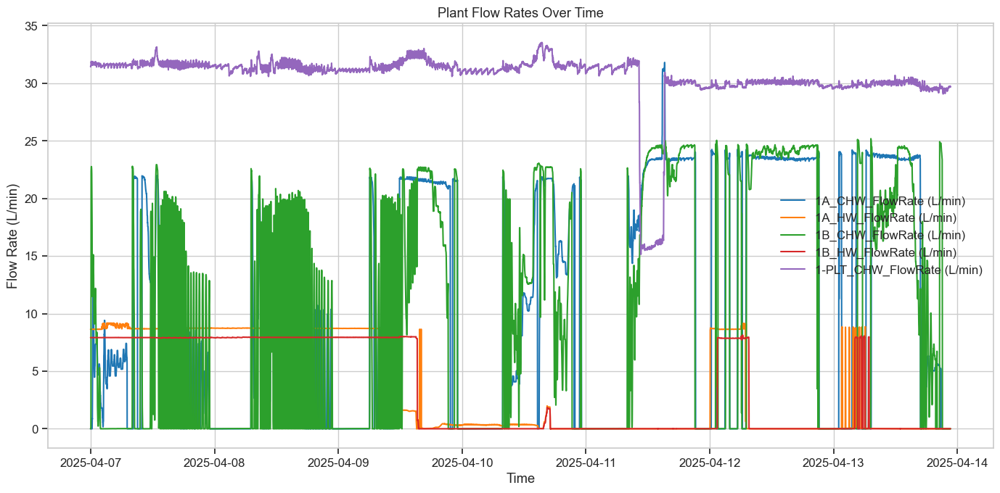

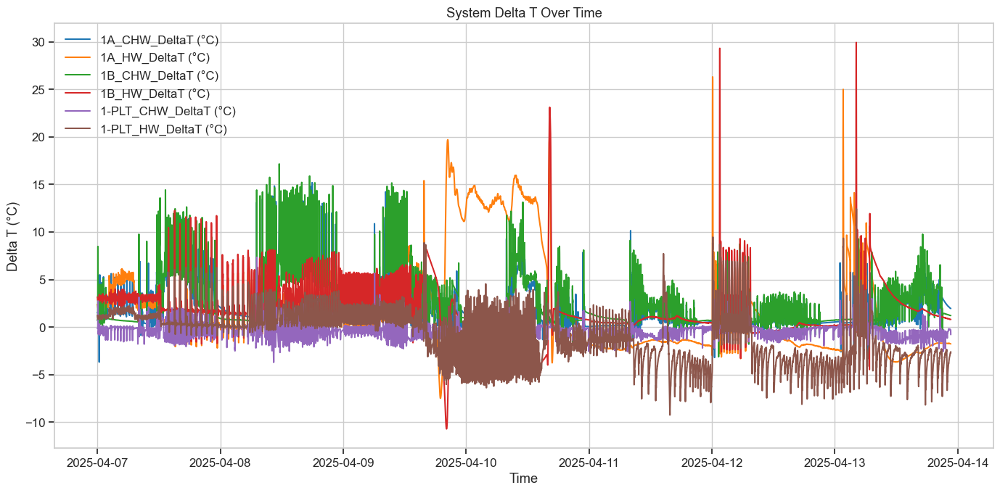

In [11]:
# Create time series plots for flow rates
plt.figure(figsize=(14, 7))
flow_cols = [col for col in df.columns if 'FlowRate' in col]

for col in flow_cols:
    plt.plot(df.index, df[col], label=f"{col} ({units.get(col, '')})")

plt.title('Plant Flow Rates Over Time')
plt.xlabel('Time')
plt.ylabel('Flow Rate (L/min)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Create time series plots for delta T
plt.figure(figsize=(14, 7))
delta_t_cols = [col for col in df.columns if 'DeltaT' in col]

for col in delta_t_cols:
    plt.plot(df.index, df[col], label=f"{col} (°C)")

plt.title('System Delta T Over Time')
plt.xlabel('Time')
plt.ylabel('Delta T (°C)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

### 2.3 Interactive Visualization of Plant Operations

In [12]:
# Create an interactive time series plot with Plotly
def create_interactive_timeseries(dataframe, column_groups, title):
    fig = make_subplots(rows=len(column_groups), cols=1, 
                        subplot_titles=[group['name'] for group in column_groups],
                        shared_xaxes=True, 
                        vertical_spacing=0.1)
    
    for i, group in enumerate(column_groups):
        for col in group['columns']:
            unit = units.get(col, '')
            fig.add_trace(
                go.Scatter(x=dataframe.index, y=dataframe[col], name=f"{col} ({unit})"),
                row=i+1, col=1
            )
    
    fig.update_layout(
        title=title,
        height=200 * len(column_groups),
        width=1000,
        showlegend=True,
        legend=dict(orientation="h", yanchor="bottom", y=-0.2)
    )
    
    return fig

# Define column groups for visualization
column_groups = [
    {
        'name': 'Chilled Water Flow Rates', 
        'columns': [col for col in df.columns if 'CHW' in col and 'FlowRate' in col]
    },
    {
        'name': 'Hot Water Flow Rates', 
        'columns': [col for col in df.columns if 'HW' in col and 'FlowRate' in col]
    },
    {
        'name': 'Chilled Water Temperatures', 
        'columns': [col for col in df.columns if 'CHW' in col and ('SupplyTemp' in col or 'ReturnTemp' in col)]
    },
    {
        'name': 'Hot Water Temperatures', 
        'columns': [col for col in df.columns if 'HW' in col and ('SupplyTemp' in col or 'ReturnTemp' in col)]
    },
    {
        'name': 'Valve Positions', 
        'columns': [col for col in df.columns if 'ValvePosition' in col]
    }
]

# Create and display the plot
fig = create_interactive_timeseries(df, column_groups, 'HVAC Plant Operations Over Time')
fig.show()

## 3. Chilled Water System Analysis
Chilled water system performance.

### 3.1 Chilled Water Temperature Control Performance

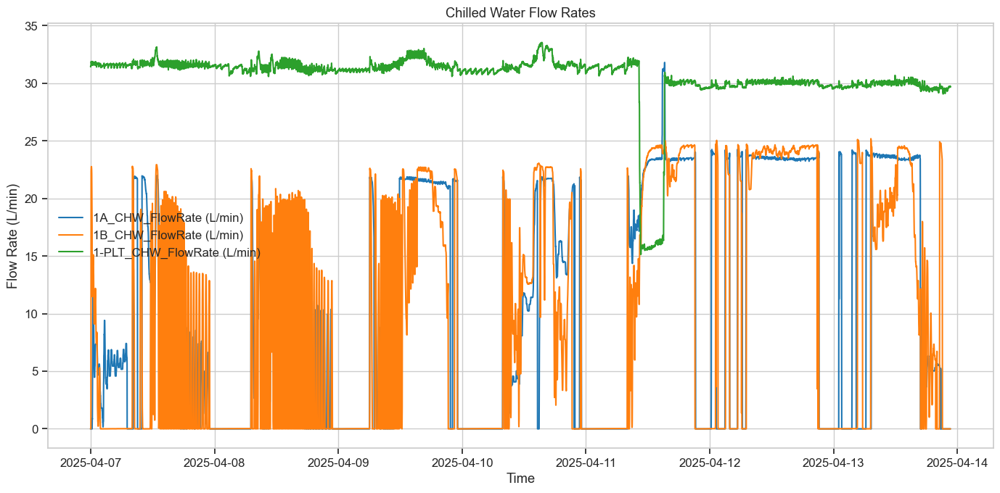

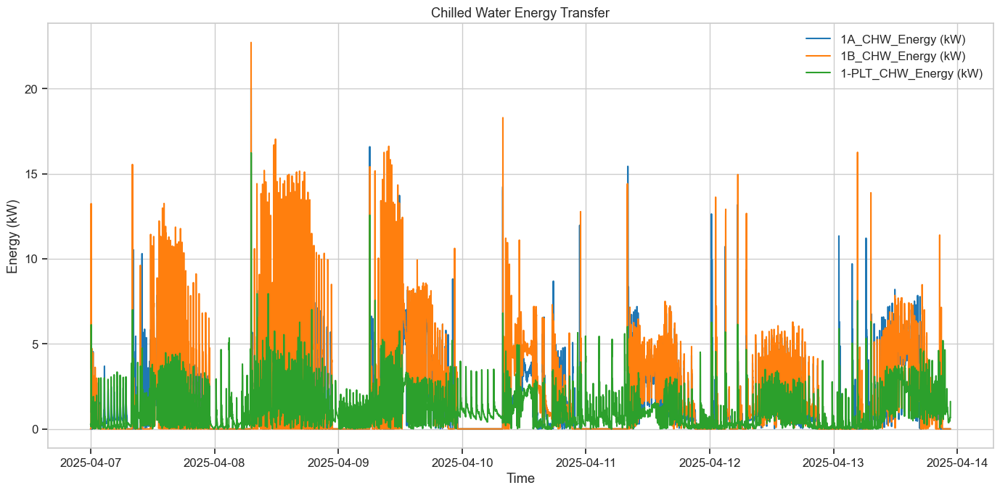

CHW Flow and Energy Transfer Metrics:

1A CHW System:
  Average Flow Rate: 10.35 L/min (Std Dev: 10.055 L/min)
  Average Energy Transfer: 1.71 kW
  Flow Stability: 97.11% (coefficient of variation)

1B CHW System:
  Average Flow Rate: 9.35 L/min (Std Dev: 10.125 L/min)
  Average Energy Transfer: 1.91 kW
  Flow Stability: 108.31% (coefficient of variation)

1-PLT CHW System:
  Average Flow Rate: 30.54 L/min (Std Dev: 2.613 L/min)
  Average Energy Transfer: 1.18 kW
  Flow Stability: 8.56% (coefficient of variation)


In [13]:
# Analyze CHW flow and energy transfer
def analyze_chw_flow_energy(df):
    # Get relevant columns
    buildings = ['1A', '1B', '1-PLT']
    flow_cols = [f'{b}_CHW_FlowRate' for b in buildings if f'{b}_CHW_FlowRate' in df.columns]
    energy_cols = [f'{b}_CHW_Energy' for b in buildings if f'{b}_CHW_Energy' in df.columns]
    
    # Create visualization for flow rates
    plt.figure(figsize=(14, 7))
    
    # Plot flow rates
    for col in flow_cols:
        plt.plot(df.index, df[col], label=f"{col} (L/min)")
    
    plt.title('Chilled Water Flow Rates')
    plt.xlabel('Time')
    plt.ylabel('Flow Rate (L/min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    # Create visualization for energy transfer
    if energy_cols:
        plt.figure(figsize=(14, 7))
        
        # Plot energy transfer
        for col in energy_cols:
            plt.plot(df.index, df[col], label=f"{col} (kW)")
        
        plt.title('Chilled Water Energy Transfer')
        plt.xlabel('Time')
        plt.ylabel('Energy (kW)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # Calculate statistics and metrics
    print("CHW Flow and Energy Transfer Metrics:")
    for building in buildings:
        if f'{building}_CHW_FlowRate' in df.columns:
            flow_rate = df[f'{building}_CHW_FlowRate'].mean()
            flow_std = df[f'{building}_CHW_FlowRate'].std()
            
            print(f"\n{building} CHW System:")
            print(f"  Average Flow Rate: {flow_rate:.2f} L/min (Std Dev: {flow_std:.3f} L/min)")
            
            if f'{building}_CHW_Energy' in df.columns:
                energy = df[f'{building}_CHW_Energy'].mean()
                print(f"  Average Energy Transfer: {energy:.2f} kW")
                
                # Calculate flow stability (lower is better)
                if flow_rate != 0:
                    flow_stability = flow_std / abs(flow_rate) * 100
                    print(f"  Flow Stability: {flow_stability:.2f}% (coefficient of variation)")

# Run the analysis
analyze_chw_flow_energy(df)

### 3.2 Chilled Water Flow and Energy Transfer Analysis

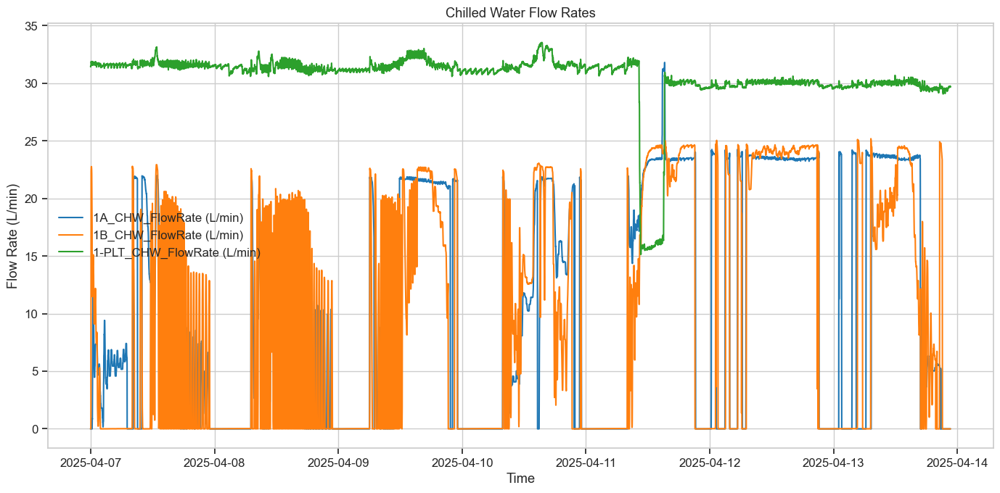

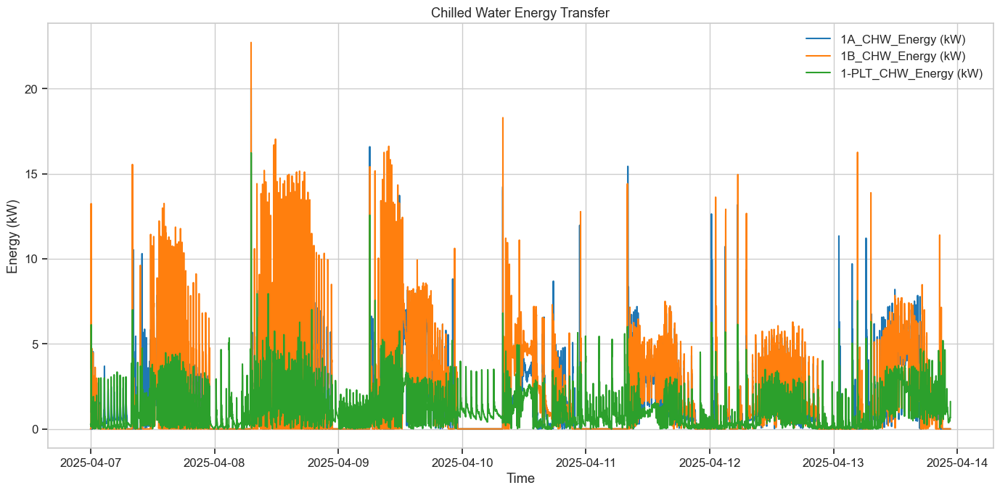

CHW Flow and Energy Transfer Metrics:

1A CHW System:
  Average Flow Rate: 10.35 L/min (Std Dev: 10.055 L/min)
  Average Energy Transfer: 1.71 kW
  Flow Stability: 97.11% (coefficient of variation)

1B CHW System:
  Average Flow Rate: 9.35 L/min (Std Dev: 10.125 L/min)
  Average Energy Transfer: 1.91 kW
  Flow Stability: 108.31% (coefficient of variation)

1-PLT CHW System:
  Average Flow Rate: 30.54 L/min (Std Dev: 2.613 L/min)
  Average Energy Transfer: 1.18 kW
  Flow Stability: 8.56% (coefficient of variation)


In [14]:
# Analyze CHW flow and energy transfer
def analyze_chw_flow_energy(df):
    # Get relevant columns
    buildings = ['1A', '1B', '1-PLT']
    flow_cols = [f'{b}_CHW_FlowRate' for b in buildings if f'{b}_CHW_FlowRate' in df.columns]
    energy_cols = [f'{b}_CHW_Energy' for b in buildings if f'{b}_CHW_Energy' in df.columns]
    
    # Create visualization for flow rates
    plt.figure(figsize=(14, 7))
    
    # Plot flow rates
    for col in flow_cols:
        plt.plot(df.index, df[col], label=f"{col} (L/min)")
    
    plt.title('Chilled Water Flow Rates')
    plt.xlabel('Time')
    plt.ylabel('Flow Rate (L/min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    # Create visualization for energy transfer
    if energy_cols:
        plt.figure(figsize=(14, 7))
        
        # Plot energy transfer
        for col in energy_cols:
            plt.plot(df.index, df[col], label=f"{col} (kW)")
        
        plt.title('Chilled Water Energy Transfer')
        plt.xlabel('Time')
        plt.ylabel('Energy (kW)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # Calculate statistics and metrics
    print("CHW Flow and Energy Transfer Metrics:")
    for building in buildings:
        if f'{building}_CHW_FlowRate' in df.columns:
            flow_rate = df[f'{building}_CHW_FlowRate'].mean()
            flow_std = df[f'{building}_CHW_FlowRate'].std()
            
            print(f"\n{building} CHW System:")
            print(f"  Average Flow Rate: {flow_rate:.2f} L/min (Std Dev: {flow_std:.3f} L/min)")
            
            if f'{building}_CHW_Energy' in df.columns:
                energy = df[f'{building}_CHW_Energy'].mean()
                print(f"  Average Energy Transfer: {energy:.2f} kW")
                
                # Calculate flow stability (lower is better)
                if flow_rate != 0:
                    flow_stability = flow_std / abs(flow_rate) * 100
                    print(f"  Flow Stability: {flow_stability:.2f}% (coefficient of variation)")

# Run the analysis
analyze_chw_flow_energy(df)

### 3.3 Chilled Water System Efficiency Analysis

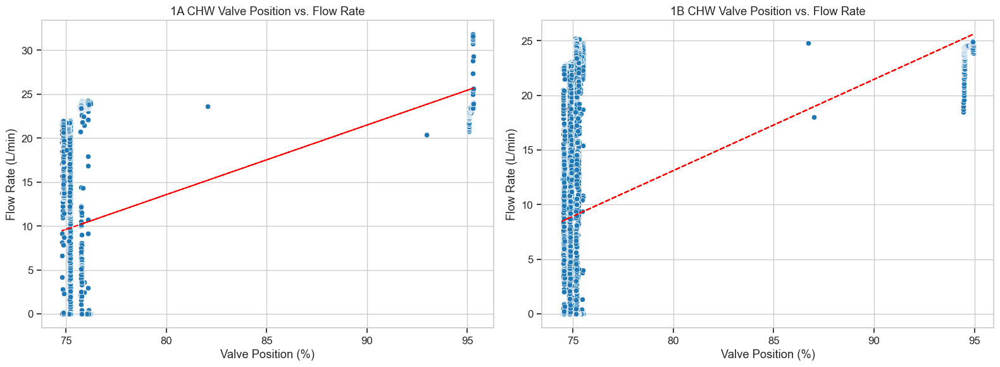

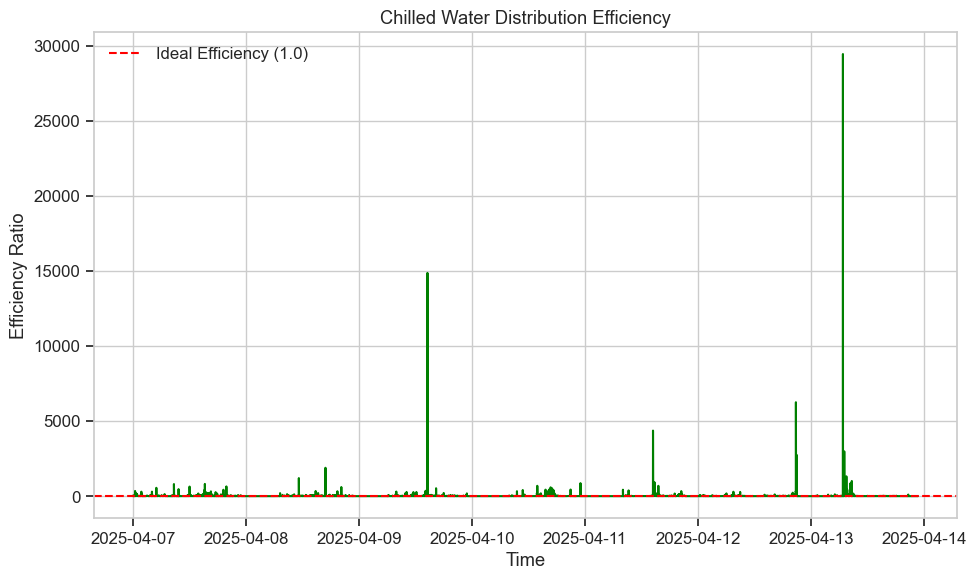

Average CHW Distribution Efficiency: 15.855
Interpretation: A value close to 1.0 indicates minimal energy loss in distribution

Chilled Water System Efficiency Metrics:

1A CHW System:
  Average Delta T: 2.56°C
  Delta T Effectiveness: 42.73% of ideal
  System Performance Classification: Poor

1B CHW System:
  Average Delta T: 2.65°C
  Delta T Effectiveness: 44.25% of ideal
  System Performance Classification: Poor

1-PLT CHW System:
  Average Delta T: -0.42°C
  Delta T Effectiveness: -6.95% of ideal
  System Performance Classification: Poor


In [15]:
# Analyze CHW system efficiency
def analyze_chw_efficiency(df):
    # Calculate efficiency metrics
    
    # 1. Delta T effectiveness - higher is better
    # Ideal delta T is typically 5-7°C for chilled water systems
    ideal_delta_t = 6  # °C
    
    for building in ['1A', '1B', '1-PLT']:
        if f'{building}_CHW_DeltaT' in df.columns:
            df[f'{building}_CHW_DeltaT_Effectiveness'] = df[f'{building}_CHW_DeltaT'] / ideal_delta_t
    
    # 2. Valve position vs. flow relationship
    # Create scatter plots to analyze valve control effectiveness
    buildings = ['1A', '1B']
    
    fig, axes = plt.subplots(1, len(buildings), figsize=(16, 6))
    
    for i, building in enumerate(buildings):
        if f'{building}_CHW_ValvePosition' in df.columns and f'{building}_CHW_FlowRate' in df.columns:
            if len(buildings) > 1:
                ax = axes[i]
            else:
                ax = axes
                
            sns.scatterplot(
                x=df[f'{building}_CHW_ValvePosition'], 
                y=df[f'{building}_CHW_FlowRate'],
                ax=ax
            )
            
            # Add a trendline if there's enough data
            if len(df) > 2:
                m, b = np.polyfit(df[f'{building}_CHW_ValvePosition'], df[f'{building}_CHW_FlowRate'], 1)
                ax.plot(df[f'{building}_CHW_ValvePosition'], m*df[f'{building}_CHW_ValvePosition'] + b, 'r--')
            
            ax.set_title(f'{building} CHW Valve Position vs. Flow Rate')
            ax.set_xlabel('Valve Position (%)')
            ax.set_ylabel('Flow Rate (L/min)')
            ax.grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # 3. Distribution efficiency analysis
    if 'CHW_Distribution_Efficiency' in df.columns:
        plt.figure(figsize=(10, 6))
        plt.plot(df.index, df['CHW_Distribution_Efficiency'], 'g-')
        plt.title('Chilled Water Distribution Efficiency')
        plt.xlabel('Time')
        plt.ylabel('Efficiency Ratio')
        plt.axhline(y=1.0, color='r', linestyle='--', label='Ideal Efficiency (1.0)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
        
        # Calculate statistics
        avg_efficiency = df['CHW_Distribution_Efficiency'].mean()
        print(f"Average CHW Distribution Efficiency: {avg_efficiency:.3f}")
        print(f"Interpretation: A value close to 1.0 indicates minimal energy loss in distribution")
    
    # 4. Calculate and display overall efficiency metrics
    print("\nChilled Water System Efficiency Metrics:")
    
    for building in ['1A', '1B', '1-PLT']:
        if f'{building}_CHW_DeltaT' in df.columns:
            delta_t = df[f'{building}_CHW_DeltaT'].mean()
            delta_t_effectiveness = (df[f'{building}_CHW_DeltaT_Effectiveness'].mean() * 100)
            
            print(f"\n{building} CHW System:")
            print(f"  Average Delta T: {delta_t:.2f}°C")
            print(f"  Delta T Effectiveness: {delta_t_effectiveness:.2f}% of ideal")
            
            # Classify the system performance
            if delta_t_effectiveness >= 90:
                performance = "Excellent"
            elif delta_t_effectiveness >= 75:
                performance = "Good"
            elif delta_t_effectiveness >= 60:
                performance = "Fair"
            else:
                performance = "Poor"
                
            print(f"  System Performance Classification: {performance}")

# Run the analysis
analyze_chw_efficiency(df)

## 4. Hot Water System Analysis
Analyze the hot water system performance.

### 4.1 Hot Water Temperature Control Performance

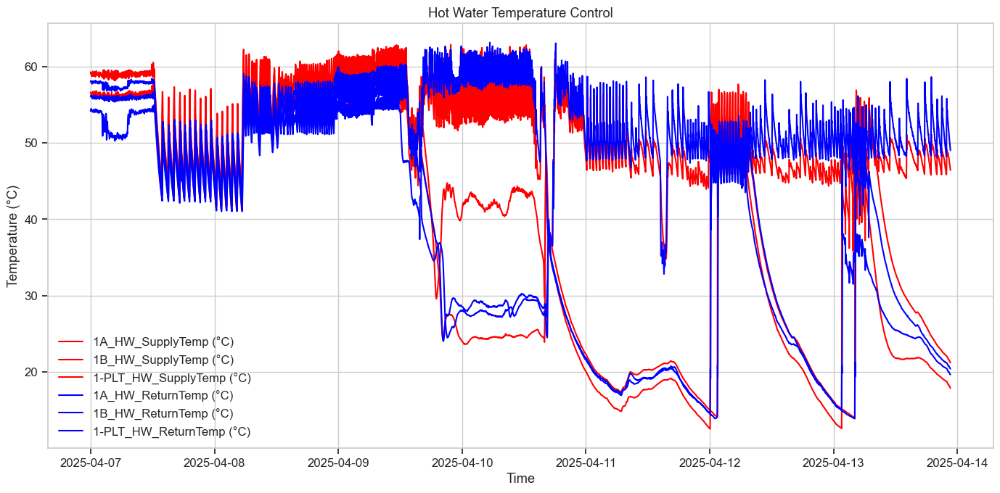

HW Temperature Control Metrics:

1A HW System:
  Average Supply Temperature: 38.40°C (Std Dev: 15.218°C)
  Average Return Temperature: 36.08°C
  Average Delta T: 2.31°C
  Supply Temperature Stability: 39.63% (coefficient of variation)

1B HW System:
  Average Supply Temperature: 38.37°C (Std Dev: 16.209°C)
  Average Return Temperature: 36.89°C
  Average Delta T: 1.48°C
  Supply Temperature Stability: 42.24% (coefficient of variation)

1-PLT HW System:
  Average Supply Temperature: 52.09°C (Std Dev: 5.408°C)
  Average Return Temperature: 53.16°C
  Average Delta T: -1.07°C
  Supply Temperature Stability: 10.38% (coefficient of variation)


In [16]:
# Analyze HW temperature control performance
def analyze_hw_temp_control(df):
    # Get relevant columns
    buildings = ['1A', '1B', '1-PLT']
    supply_temps = [f'{b}_HW_SupplyTemp' for b in buildings if f'{b}_HW_SupplyTemp' in df.columns]
    return_temps = [f'{b}_HW_ReturnTemp' for b in buildings if f'{b}_HW_ReturnTemp' in df.columns]
    
    # Create visualization
    plt.figure(figsize=(14, 7))
    
    # Plot supply temperatures
    for col in supply_temps:
        plt.plot(df.index, df[col], 'r-', label=f"{col} (°C)")
    
    # Plot return temperatures
    for col in return_temps:
        plt.plot(df.index, df[col], 'b-', label=f"{col} (°C)")
    
    plt.title('Hot Water Temperature Control')
    plt.xlabel('Time')
    plt.ylabel('Temperature (°C)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    # Calculate statistics and metrics
    print("HW Temperature Control Metrics:")
    for building in buildings:
        if f'{building}_HW_SupplyTemp' in df.columns and f'{building}_HW_ReturnTemp' in df.columns:
            supply_temp = df[f'{building}_HW_SupplyTemp'].mean()
            return_temp = df[f'{building}_HW_ReturnTemp'].mean()
            delta_t = df[f'{building}_HW_DeltaT'].mean()
            supply_std = df[f'{building}_HW_SupplyTemp'].std()
            
            print(f"\n{building} HW System:")
            print(f"  Average Supply Temperature: {supply_temp:.2f}°C (Std Dev: {supply_std:.3f}°C)")
            print(f"  Average Return Temperature: {return_temp:.2f}°C")
            print(f"  Average Delta T: {delta_t:.2f}°C")
            
            # Calculate temperature stability (lower is better)
            temp_stability = df[f'{building}_HW_SupplyTemp'].std() / df[f'{building}_HW_SupplyTemp'].mean() * 100
            print(f"  Supply Temperature Stability: {temp_stability:.2f}% (coefficient of variation)")

# Run the analysis
analyze_hw_temp_control(df)

### 4.2 Hot Water Flow and Energy Transfer Analysis

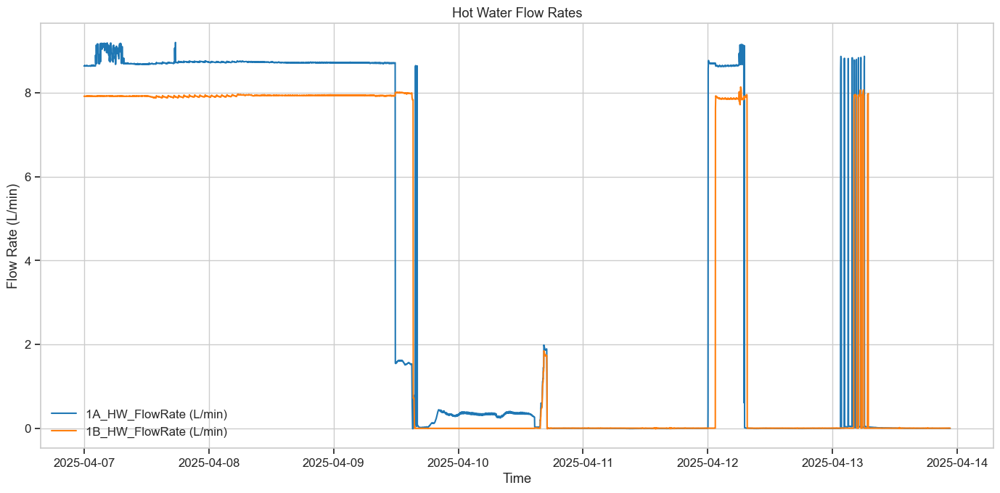

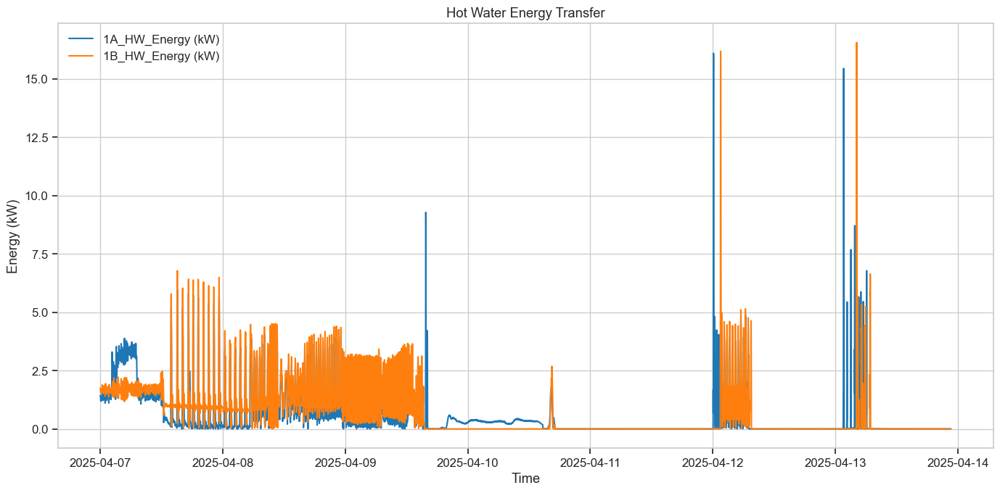

HW Flow and Energy Transfer Metrics:

1A HW System:
  Average Flow Rate: 3.63 L/min (Std Dev: 4.224 L/min)
  Average Energy Transfer: 0.64 kW
  Flow Stability: 116.31% (coefficient of variation)

1B HW System:
  Average Flow Rate: 3.38 L/min (Std Dev: 3.906 L/min)
  Average Energy Transfer: 0.72 kW
  Flow Stability: 115.55% (coefficient of variation)


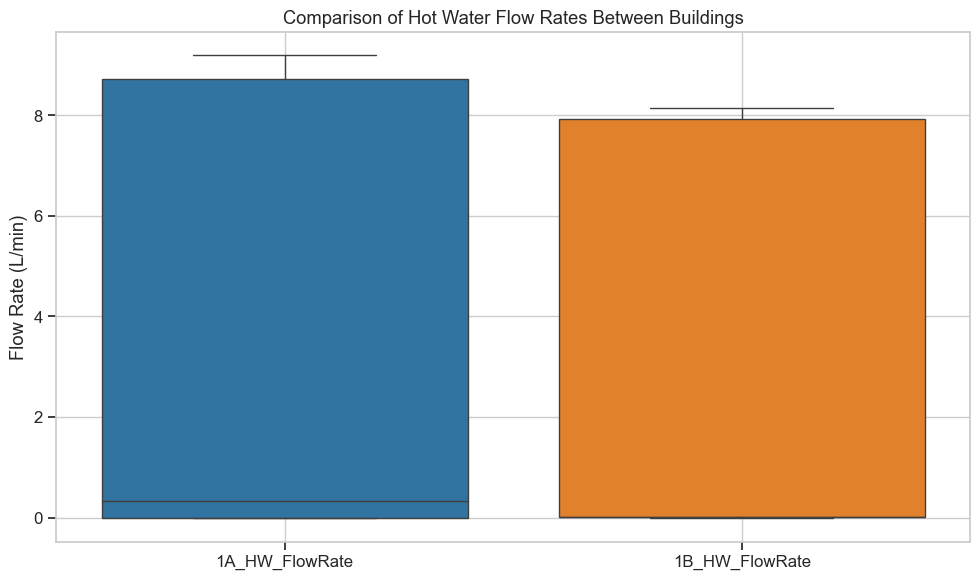

In [17]:
# Analyze HW flow and energy transfer
def analyze_hw_flow_energy(df):
    # Get relevant columns
    buildings = ['1A', '1B']  # Plant-level flow rate not available in this dataset
    flow_cols = [f'{b}_HW_FlowRate' for b in buildings if f'{b}_HW_FlowRate' in df.columns]
    energy_cols = [f'{b}_HW_Energy' for b in buildings if f'{b}_HW_Energy' in df.columns]
    
    # Create visualization for flow rates
    plt.figure(figsize=(14, 7))
    
    # Plot flow rates
    for col in flow_cols:
        plt.plot(df.index, df[col], label=f"{col} (L/min)")
    
    plt.title('Hot Water Flow Rates')
    plt.xlabel('Time')
    plt.ylabel('Flow Rate (L/min)')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    
    # Create visualization for energy transfer
    if energy_cols:
        plt.figure(figsize=(14, 7))
        
        # Plot energy transfer
        for col in energy_cols:
            plt.plot(df.index, df[col], label=f"{col} (kW)")
        
        plt.title('Hot Water Energy Transfer')
        plt.xlabel('Time')
        plt.ylabel('Energy (kW)')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # Calculate statistics and metrics
    print("HW Flow and Energy Transfer Metrics:")
    for building in buildings:
        if f'{building}_HW_FlowRate' in df.columns:
            flow_rate = df[f'{building}_HW_FlowRate'].mean()
            flow_std = df[f'{building}_HW_FlowRate'].std()
            
            print(f"\n{building} HW System:")
            print(f"  Average Flow Rate: {flow_rate:.2f} L/min (Std Dev: {flow_std:.3f} L/min)")
            
            if f'{building}_HW_Energy' in df.columns:
                energy = df[f'{building}_HW_Energy'].mean()
                print(f"  Average Energy Transfer: {energy:.2f} kW")
                
                # Calculate flow stability (lower is better)
                if flow_rate != 0:
                    flow_stability = flow_std / abs(flow_rate) * 100
                    print(f"  Flow Stability: {flow_stability:.2f}% (coefficient of variation)")
    
    # Compare flow rates between buildings
    if len(flow_cols) > 1:
        plt.figure(figsize=(10, 6))
        sns.boxplot(data=df[flow_cols])
        plt.title('Comparison of Hot Water Flow Rates Between Buildings')
        plt.ylabel('Flow Rate (L/min)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Run the analysis
analyze_hw_flow_energy(df)

### 4.3 Hot Water System Efficiency Analysis

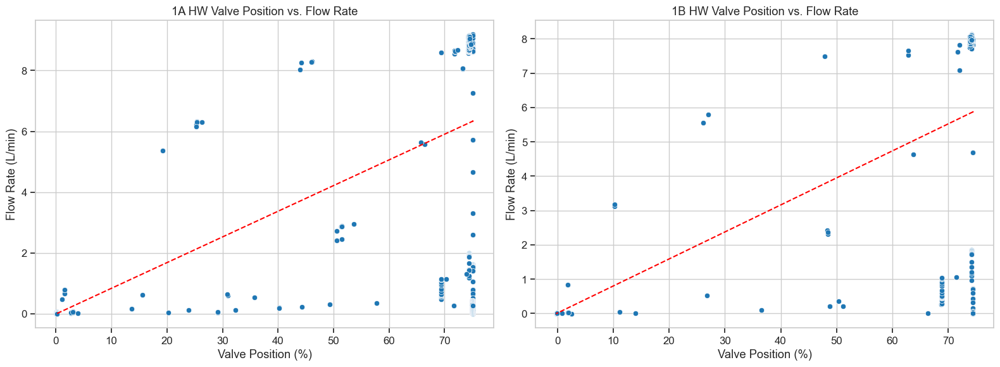


Hot Water System Efficiency Metrics:

1A HW System:
  Average Delta T: 2.31°C
  Delta T Effectiveness: 15.41% of ideal
  System Performance Classification: Poor

1B HW System:
  Average Delta T: 1.48°C
  Delta T Effectiveness: 9.84% of ideal
  System Performance Classification: Poor

1-PLT HW System:
  Average Delta T: -1.07°C
  Delta T Effectiveness: -7.16% of ideal
  System Performance Classification: Poor


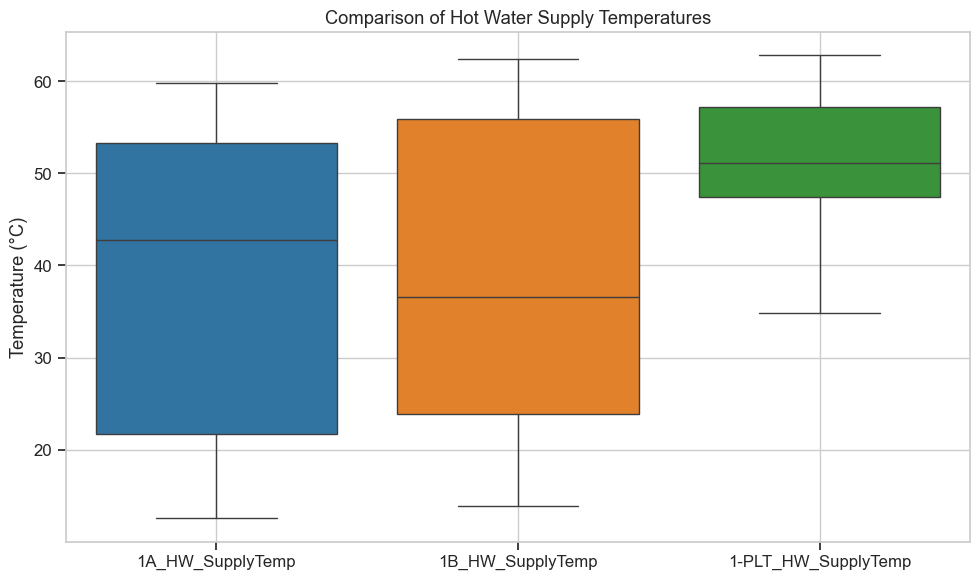

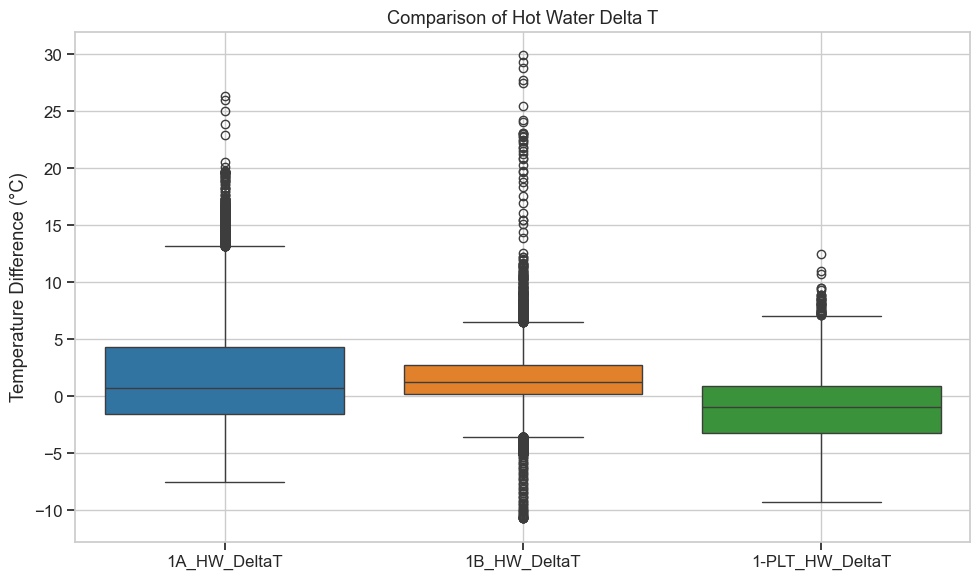

In [18]:
# Analyze HW system efficiency
def analyze_hw_efficiency(df):
    # Calculate efficiency metrics
    
    # 1. Delta T effectiveness - higher is better
    # Ideal delta T is typically 10-20°C for hot water systems depending on design
    ideal_delta_t = 15  # °C
    
    for building in ['1A', '1B', '1-PLT']:
        if f'{building}_HW_DeltaT' in df.columns:
            df[f'{building}_HW_DeltaT_Effectiveness'] = df[f'{building}_HW_DeltaT'] / ideal_delta_t
    
    # 2. Valve position vs. flow relationship
    # Create scatter plots to analyze valve control effectiveness
    buildings = ['1A', '1B']
    
    fig, axes = plt.subplots(1, len(buildings), figsize=(16, 6))
    
    for i, building in enumerate(buildings):
        if f'{building}_HW_ValvePosition' in df.columns and f'{building}_HW_FlowRate' in df.columns:
            if len(buildings) > 1:
                ax = axes[i]
            else:
                ax = axes
                
            sns.scatterplot(
                x=df[f'{building}_HW_ValvePosition'], 
                y=df[f'{building}_HW_FlowRate'],
                ax=ax
            )
            
            # Add a trendline if there's enough data
            if len(df) > 2:
                m, b = np.polyfit(df[f'{building}_HW_ValvePosition'], df[f'{building}_HW_FlowRate'], 1)
                ax.plot(df[f'{building}_HW_ValvePosition'], m*df[f'{building}_HW_ValvePosition'] + b, 'r--')
            
            ax.set_title(f'{building} HW Valve Position vs. Flow Rate')
            ax.set_xlabel('Valve Position (%)')
            ax.set_ylabel('Flow Rate (L/min)')
            ax.grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # 3. Calculate and display overall efficiency metrics
    print("\nHot Water System Efficiency Metrics:")
    
    for building in ['1A', '1B', '1-PLT']:
        if f'{building}_HW_DeltaT' in df.columns:
            delta_t = df[f'{building}_HW_DeltaT'].mean()
            if f'{building}_HW_DeltaT_Effectiveness' in df.columns:
                delta_t_effectiveness = (df[f'{building}_HW_DeltaT_Effectiveness'].mean() * 100)
                
                print(f"\n{building} HW System:")
                print(f"  Average Delta T: {delta_t:.2f}°C")
                print(f"  Delta T Effectiveness: {delta_t_effectiveness:.2f}% of ideal")
                
                # Classify the system performance
                if delta_t_effectiveness >= 90:
                    performance = "Excellent"
                elif delta_t_effectiveness >= 75:
                    performance = "Good"
                elif delta_t_effectiveness >= 60:
                    performance = "Fair"
                else:
                    performance = "Poor"
                    
                print(f"  System Performance Classification: {performance}")
    
    # 4. Analyze supply and return temperature differences between buildings
    
    # Compare supply temperatures between buildings
    supply_temps = [f'{b}_HW_SupplyTemp' for b in ['1A', '1B', '1-PLT'] if f'{b}_HW_SupplyTemp' in df.columns]
    if len(supply_temps) > 1:
        plt.figure(figsize=(10, 6))
        sns.boxplot(data=df[supply_temps])
        plt.title('Comparison of Hot Water Supply Temperatures')
        plt.ylabel('Temperature (°C)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # Compare delta T between buildings
    delta_ts = [f'{b}_HW_DeltaT' for b in ['1A', '1B', '1-PLT'] if f'{b}_HW_DeltaT' in df.columns]
    if len(delta_ts) > 1:
        plt.figure(figsize=(10, 6))
        sns.boxplot(data=df[delta_ts])
        plt.title('Comparison of Hot Water Delta T')
        plt.ylabel('Temperature Difference (°C)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()

# Run the analysis
analyze_hw_efficiency(df)

## 5. Comparative Plant Performance Analysis
Compare the performance of different plant systems side by side to identify patterns and differences.

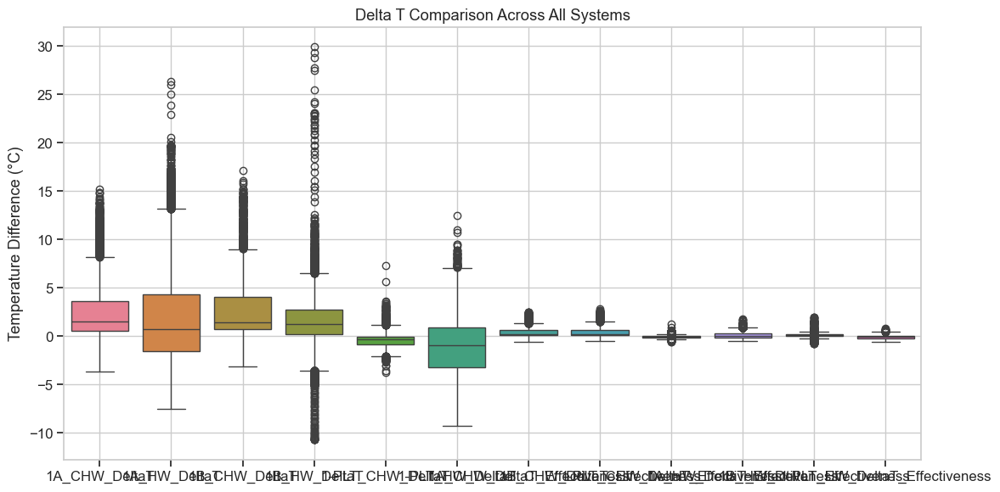

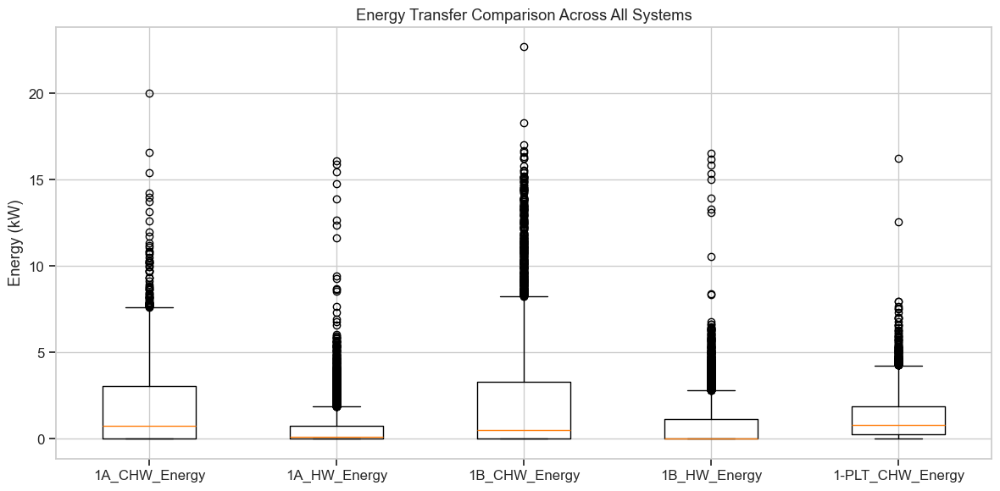

System Operation Consistency (Coefficient of Variation, lower is better):
   System  SupplyTemp  ReturnTemp  FlowRate  ValvePosition
0  1A_CHW       23.87       20.36     97.11           4.35
1  1B_CHW       26.37       21.61    108.31           4.34
2   1A_HW       39.63       37.51    116.31          85.67
3   1B_HW       42.24       40.11    115.55          85.97


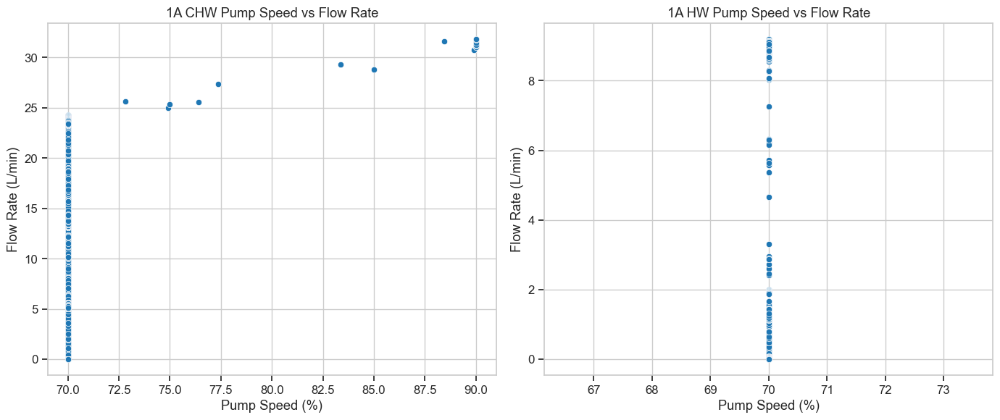

In [19]:
# Comparative analysis of chilled water and hot water systems
def compare_system_performance(df):
    # 1. Compare delta T across all systems
    delta_t_cols = [col for col in df.columns if 'DeltaT' in col]
    
    if delta_t_cols:
        plt.figure(figsize=(12, 6))
        sns.boxplot(data=df[delta_t_cols])
        plt.title('Delta T Comparison Across All Systems')
        plt.ylabel('Temperature Difference (°C)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # 2. Compare energy transfer across all systems
    energy_cols = [col for col in df.columns if 'Energy' in col and 'Efficiency' not in col]
    
    if energy_cols:
        plt.figure(figsize=(12, 6))
        plt.boxplot([df[col].dropna() for col in energy_cols], labels=energy_cols)
        plt.title('Energy Transfer Comparison Across All Systems')
        plt.ylabel('Energy (kW)')
        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    # 3. Analyze system operation consistency
    # Create a table of coefficient of variation for key metrics
    systems = ['1A_CHW', '1B_CHW', '1A_HW', '1B_HW']
    metrics = ['SupplyTemp', 'ReturnTemp', 'FlowRate', 'ValvePosition']
    
    cv_data = []
    
    for system in systems:
        row = {'System': system}
        
        for metric in metrics:
            col = f"{system}_{metric}"
            if col in df.columns and df[col].mean() != 0:
                cv = (df[col].std() / abs(df[col].mean()) * 100)
                row[metric] = cv
        
        cv_data.append(row)
    
    cv_df = pd.DataFrame(cv_data)
    
    print("System Operation Consistency (Coefficient of Variation, lower is better):")
    print(cv_df.round(2))
    
    # 4. Compare relationship between pump speed and flow rate
    if '1A_CHW_PumpSpeed' in df.columns and '1A_CHW_FlowRate' in df.columns:
        plt.figure(figsize=(14, 6))
        
        # Plot for CHW systems
        plt.subplot(1, 2, 1)
        sns.scatterplot(x=df['1A_CHW_PumpSpeed'], y=df['1A_CHW_FlowRate'])
        plt.title('1A CHW Pump Speed vs Flow Rate')
        plt.xlabel('Pump Speed (%)')
        plt.ylabel('Flow Rate (L/min)')
        plt.grid(True)
        
        # Plot for HW systems
        plt.subplot(1, 2, 2)
        sns.scatterplot(x=df['1A_HW_PumpSpeed'], y=df['1A_HW_FlowRate'])
        plt.title('1A HW Pump Speed vs Flow Rate')
        plt.xlabel('Pump Speed (%)')
        plt.ylabel('Flow Rate (L/min)')
        plt.grid(True)
        
        plt.tight_layout()
        plt.show()

# Run the comparative analysis
compare_system_performance(df)

## 6. Main Plant vs. Building Level Analysis
Analyze the relationship between the main plant operations and the building-level systems.


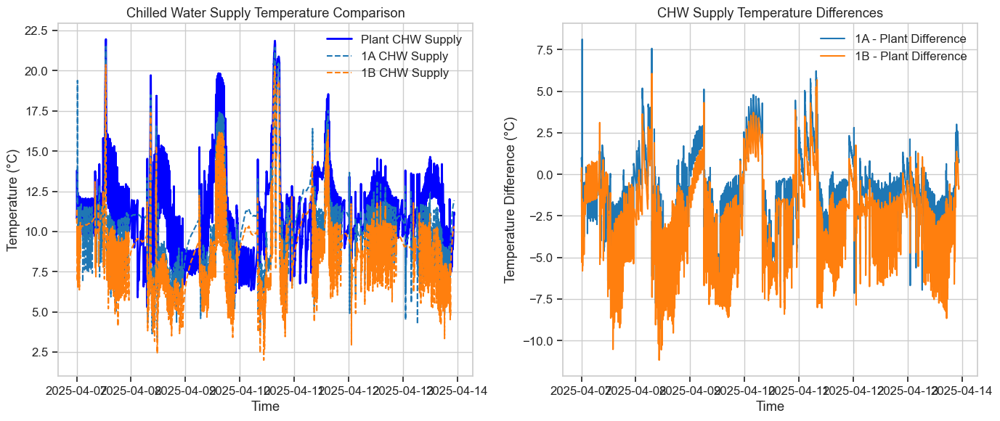

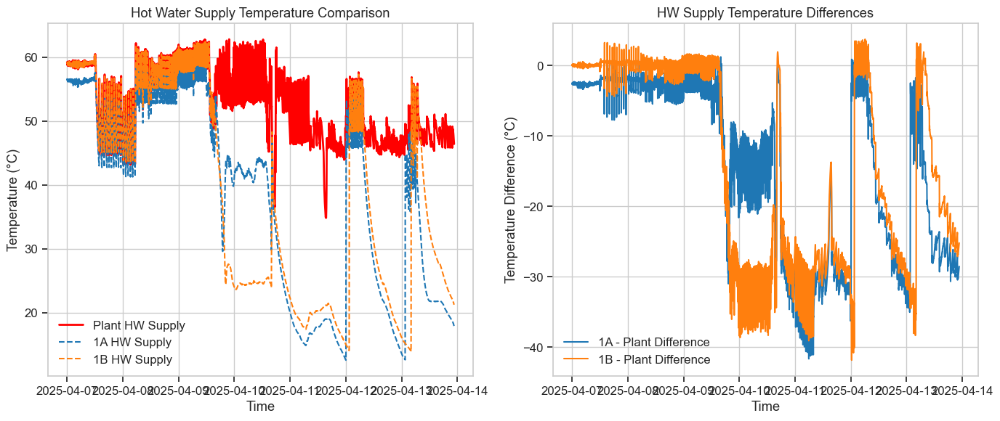

Temperature Losses in Distribution:

Chilled Water Supply Temperature Losses:
  1A Building: -1.45°C
  1B Building: -2.52°C

Hot Water Supply Temperature Losses:
  1A Building: 13.70°C
  1B Building: 13.72°C

CHW Flow Distribution:
  Plant Total Flow: 30.54 L/min
  1A Flow: 10.35 L/min (52.6%)
  1B Flow: 9.35 L/min (47.4%)


In [20]:
# Analyze the relationship between plant and building level systems
def analyze_plant_building_relationship(df):
    # 1. Compare plant supply temperature vs building supply temperature
    # For CHW
    if '1-PLT_CHW_SupplyTemp' in df.columns:
        plt.figure(figsize=(14, 6))
        
        # Plot all CHW supply temperatures
        plt.subplot(1, 2, 1)
        plt.plot(df.index, df['1-PLT_CHW_SupplyTemp'], 'b-', linewidth=2, label='Plant CHW Supply')
        
        for building in ['1A', '1B']:
            if f'{building}_CHW_SupplyTemp' in df.columns:
                plt.plot(df.index, df[f'{building}_CHW_SupplyTemp'], '--', label=f'{building} CHW Supply')
        
        plt.title('Chilled Water Supply Temperature Comparison')
        plt.xlabel('Time')
        plt.ylabel('Temperature (°C)')
        plt.legend()
        plt.grid(True)
        
        # Plot temperature differences
        plt.subplot(1, 2, 2)
        
        for building in ['1A', '1B']:
            if f'{building}_CHW_SupplyTemp' in df.columns and '1-PLT_CHW_SupplyTemp' in df.columns:
                temp_diff = df[f'{building}_CHW_SupplyTemp'] - df['1-PLT_CHW_SupplyTemp']
                plt.plot(df.index, temp_diff, label=f'{building} - Plant Difference')
        
        plt.title('CHW Supply Temperature Differences')
        plt.xlabel('Time')
        plt.ylabel('Temperature Difference (°C)')
        plt.legend()
        plt.grid(True)
        
        plt.tight_layout()
        plt.show()
    
    # For HW
    if '1-PLT_HW_SupplyTemp' in df.columns:
        plt.figure(figsize=(14, 6))
        
        # Plot all HW supply temperatures
        plt.subplot(1, 2, 1)
        plt.plot(df.index, df['1-PLT_HW_SupplyTemp'], 'r-', linewidth=2, label='Plant HW Supply')
        
        for building in ['1A', '1B']:
            if f'{building}_HW_SupplyTemp' in df.columns:
                plt.plot(df.index, df[f'{building}_HW_SupplyTemp'], '--', label=f'{building} HW Supply')
        
        plt.title('Hot Water Supply Temperature Comparison')
        plt.xlabel('Time')
        plt.ylabel('Temperature (°C)')
        plt.legend()
        plt.grid(True)
        
        # Plot temperature differences
        plt.subplot(1, 2, 2)
        
        for building in ['1A', '1B']:
            if f'{building}_HW_SupplyTemp' in df.columns and '1-PLT_HW_SupplyTemp' in df.columns:
                temp_diff = df[f'{building}_HW_SupplyTemp'] - df['1-PLT_HW_SupplyTemp']
                plt.plot(df.index, temp_diff, label=f'{building} - Plant Difference')
        
        plt.title('HW Supply Temperature Differences')
        plt.xlabel('Time')
        plt.ylabel('Temperature Difference (°C)')
        plt.legend()
        plt.grid(True)
        
        plt.tight_layout()
        plt.show()
    
    # 2. Calculate temperature losses in distribution
    print("Temperature Losses in Distribution:")
    
    # CHW temperature losses
    if '1-PLT_CHW_SupplyTemp' in df.columns:
        print("\nChilled Water Supply Temperature Losses:")
        for building in ['1A', '1B']:
            if f'{building}_CHW_SupplyTemp' in df.columns:
                avg_loss = (df[f'{building}_CHW_SupplyTemp'] - df['1-PLT_CHW_SupplyTemp']).mean()
                print(f"  {building} Building: {avg_loss:.2f}°C")
    
    # HW temperature losses
    if '1-PLT_HW_SupplyTemp' in df.columns:
        print("\nHot Water Supply Temperature Losses:")
        for building in ['1A', '1B']:
            if f'{building}_HW_SupplyTemp' in df.columns:
                avg_loss = (df['1-PLT_HW_SupplyTemp'] - df[f'{building}_HW_SupplyTemp']).mean()
                print(f"  {building} Building: {avg_loss:.2f}°C")
    
    # 3. Flow distribution among buildings
    if '1-PLT_CHW_FlowRate' in df.columns and '1A_CHW_FlowRate' in df.columns and '1B_CHW_FlowRate' in df.columns:
        total_building_flow = df['1A_CHW_FlowRate'] + df['1B_CHW_FlowRate']
        
        print("\nCHW Flow Distribution:")
        print(f"  Plant Total Flow: {df['1-PLT_CHW_FlowRate'].mean():.2f} L/min")
        print(f"  1A Flow: {df['1A_CHW_FlowRate'].mean():.2f} L/min ({df['1A_CHW_FlowRate'].mean() / total_building_flow.mean() * 100:.1f}%)")
        print(f"  1B Flow: {df['1B_CHW_FlowRate'].mean():.2f} L/min ({df['1B_CHW_FlowRate'].mean() / total_building_flow.mean() * 100:.1f}%)")

# Run the analysis
analyze_plant_building_relationship(df)

## 7. System Performance Scoring and Recommendations

System Performance Scores (0-100, higher is better):


,Temperature Stability,Delta T Performance,Flow Stability,Control Response,Overall Score
1A_CHW,0,42.734816,0,26.006664,NaN
1B_CHW,0,44.249515,0,27.017882,NaN
1A_HW,0,15.410138,0,73.868097,NaN
1B_HW,0,9.840372,0,74.14324,NaN


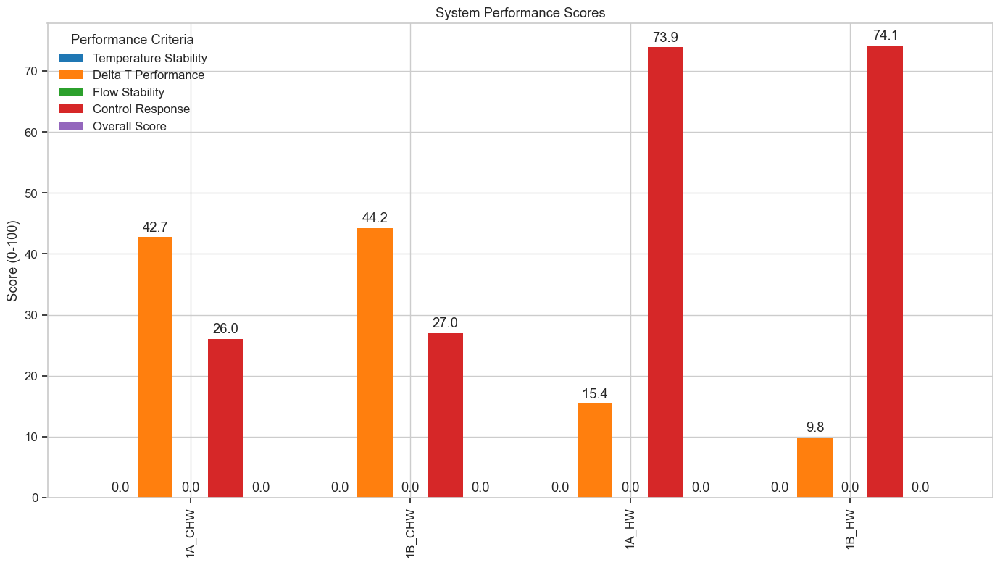


System Improvement Recommendations:

1A_CHW System:
  Areas for improvement:
    - Temperature Stability: 0.0/100
      Recommendation: Check control valve operation and PID tuning parameters.
      Recommendation: Verify sensor calibration and placement.
    - Flow Stability: 0.0/100
      Recommendation: Verify pump control parameters and check for hunting.
      Recommendation: Inspect differential pressure sensor operation.
  Strongest performance area:
    - Delta T Performance: 42.7/100

1B_CHW System:
  Areas for improvement:
    - Temperature Stability: 0.0/100
      Recommendation: Check control valve operation and PID tuning parameters.
      Recommendation: Verify sensor calibration and placement.
    - Flow Stability: 0.0/100
      Recommendation: Verify pump control parameters and check for hunting.
      Recommendation: Inspect differential pressure sensor operation.
  Strongest performance area:
    - Delta T Performance: 44.2/100

1A_HW System:
  Areas for improvement:

In [21]:
# Create performance scores and recommendations
def score_system_performance(df):
    # Define scoring criteria and weights
    criteria = {
        'temp_stability': {
            'weight': 0.25,
            'description': 'Temperature Stability',
            'ideal': 'low coefficient of variation'
        },
        'delta_t': {
            'weight': 0.30,
            'description': 'Delta T Performance',
            'ideal': 'high delta T'
        },
        'flow_stability': {
            'weight': 0.20,
            'description': 'Flow Stability',
            'ideal': 'low coefficient of variation'
        },
        'control_response': {
            'weight': 0.25,
            'description': 'Control Response',
            'ideal': 'high correlation between valve position and flow'
        }
    }
    
    # Create dataframe to store scores
    systems = ['1A_CHW', '1B_CHW', '1A_HW', '1B_HW']
    score_columns = [c['description'] for c in criteria.values()] + ['Overall Score']
    scores = pd.DataFrame(index=systems, columns=score_columns)
    
    # Calculate scores for each system
    for system in systems:
        building, type_sys = system.split('_')
        
        # Temperature stability score (0-100, higher is better)
        if f'{system}_SupplyTemp' in df.columns:
            cv = df[f'{system}_SupplyTemp'].std() / abs(df[f'{system}_SupplyTemp'].mean()) * 100
            temp_stability_score = max(0, 100 - cv * 10)  # Lower CV is better
            scores.loc[system, 'Temperature Stability'] = temp_stability_score
        
        # Delta T performance score
        if f'{system}_DeltaT' in df.columns:
            if type_sys == 'CHW':
                # For CHW, typical good delta T is 5-7°C
                ideal_delta_t = 6
            else:
                # For HW, typical good delta T is 10-20°C
                ideal_delta_t = 15
            
            actual_delta_t = abs(df[f'{system}_DeltaT'].mean())
            delta_t_score = min(100, (actual_delta_t / ideal_delta_t) * 100)
            scores.loc[system, 'Delta T Performance'] = delta_t_score
        
        # Flow stability score
        if f'{system}_FlowRate' in df.columns and df[f'{system}_FlowRate'].mean() != 0:
            flow_cv = df[f'{system}_FlowRate'].std() / abs(df[f'{system}_FlowRate'].mean()) * 100
            flow_stability_score = max(0, 100 - flow_cv * 5)  # Lower CV is better
            scores.loc[system, 'Flow Stability'] = flow_stability_score
        
        # Control response score
        if f'{system}_ValvePosition' in df.columns and f'{system}_FlowRate' in df.columns:
            # Calculate correlation
            corr = df[[f'{system}_ValvePosition', f'{system}_FlowRate']].corr().iloc[0, 1]
            # Convert correlation to score (0-100)
            control_response_score = abs(corr) * 100
            scores.loc[system, 'Control Response'] = control_response_score
        
        # # Calculate overall score (weighted average)
        # row_scores = scores.loc[system, :-1].dropna()
        # if not row_scores.empty:
        #     weights = []
        #     for c in criteria.keys():
        #         desc = criteria[c]['description']
        #         if desc in row_scores.index:
        #             weights.append(criteria[c]['weight'])
            
        #     weights = [w/sum(weights) for w in weights]  # Normalize weights
        #     overall_score = sum(row_scores * weights)
        #     scores.loc[system, 'Overall Score'] = overall_score
    
    # Display scores
    print("System Performance Scores (0-100, higher is better):")
    display(scores.round(1))
    
    # Create visualization of scores
    ax = scores.plot(kind='bar', figsize=(14, 8), width=0.8)
    plt.title('System Performance Scores')
    plt.ylabel('Score (0-100)')
    plt.grid(True, axis='y')
    plt.legend(title='Performance Criteria')
    
    # Add value labels on bars
    for container in ax.containers:
        ax.bar_label(container, fmt='%.1f', padding=3)
    
    plt.tight_layout()
    plt.show()
    
    # Generate recommendations based on scores
    print("\nSystem Improvement Recommendations:")
    
    for system in systems:
        print(f"\n{system} System:")
        
        # Get scores and identify areas for improvement
        system_scores = scores.loc[system].dropna()
        if 'Overall Score' in system_scores.index:
            print(f"  Overall Performance Score: {system_scores['Overall Score']:.1f}/100")
        
        # Find lowest scoring areas (exclude Overall Score from this analysis)
        performance_scores = system_scores.drop('Overall Score', errors='ignore')
        if not performance_scores.empty:
            min_score = performance_scores.min()
            min_areas = performance_scores[performance_scores == min_score].index.tolist()
            
            print(f"  Areas for improvement:")
            for area in min_areas:
                print(f"    - {area}: {min_score:.1f}/100")
                
                # Provide specific recommendations based on the area
                if area == 'Temperature Stability':
                    print(f"      Recommendation: Check control valve operation and PID tuning parameters.")
                    print(f"      Recommendation: Verify sensor calibration and placement.")
                
                elif area == 'Delta T Performance':
                    if 'CHW' in system:
                        print(f"      Recommendation: Increase chilled water flow or reduce supply temperature.")
                        print(f"      Recommendation: Check for potential coil fouling or air in the system.")
                    else:
                        print(f"      Recommendation: Decrease hot water flow or increase supply temperature.")
                        print(f"      Recommendation: Check balancing valves and system design.")
                
                elif area == 'Flow Stability':
                    print(f"      Recommendation: Verify pump control parameters and check for hunting.")
                    print(f"      Recommendation: Inspect differential pressure sensor operation.")
                
                elif area == 'Control Response':
                    print(f"      Recommendation: Check valve actuator operation and calibration.")
                    print(f"      Recommendation: Verify control sequence logic and setpoints.")
        
        # Identify best performing area
        if not performance_scores.empty:
            max_score = performance_scores.max()
            max_areas = performance_scores[performance_scores == max_score].index.tolist()
            
            print(f"  Strongest performance area:")
            for area in max_areas:
                print(f"    - {area}: {max_score:.1f}/100")
                
score_system_performance(df)

## 8. Energy Analysis and Efficiency Opportunities

In [22]:
# Analyze energy usage and identify efficiency opportunities
def analyze_energy_efficiency(df):
    # 1. Calculate total energy usage by system type
    print("Energy Usage Analysis:")
    
    # Chilled water energy
    chw_energy_cols = [col for col in df.columns if 'CHW' in col and 'Energy' in col and 'Efficiency' not in col]
    if chw_energy_cols:
        total_chw_energy = sum(df[col].mean() for col in chw_energy_cols if not df[col].isna().all())
        print(f"\nTotal CHW Energy Transfer: {total_chw_energy:.2f} kW")
        
        # Breakdown by building
        for col in chw_energy_cols:
            building = col.split('_')[0]
            energy = df[col].mean()
            if total_chw_energy > 0:
                print(f"  {building} CHW: {energy:.2f} kW ({energy/total_chw_energy*100:.1f}%)")
    
    # Hot water energy
    hw_energy_cols = [col for col in df.columns if 'HW' in col and 'Energy' in col and 'Efficiency' not in col]
    if hw_energy_cols:
        total_hw_energy = sum(df[col].mean() for col in hw_energy_cols if not df[col].isna().all())
        print(f"\nTotal HW Energy Transfer: {total_hw_energy:.2f} kW")
        
        # Breakdown by building
        for col in hw_energy_cols:
            building = col.split('_')[0]
            energy = df[col].mean()
            if total_hw_energy > 0:
                print(f"  {building} HW: {energy:.2f} kW ({energy/total_hw_energy*100:.1f}%)")
    
    # 2. Energy efficiency opportunities based on delta T
    print("\nDelta T-Based Efficiency Opportunities:")
    
    for system_type in ['CHW', 'HW']:
        ideal_delta_t = 6 if system_type == 'CHW' else 15
        
        for building in ['1A', '1B', '1-PLT']:
            col = f'{building}_{system_type}_DeltaT'
            if col in df.columns:
                actual_delta_t = abs(df[col].mean())
                effectiveness = (actual_delta_t / ideal_delta_t) * 100
                
                if effectiveness < 70:
                    energy_impact = "high"
                elif effectiveness < 85:
                    energy_impact = "medium"
                else:
                    energy_impact = "low"
                
                print(f"\n{building} {system_type} System:")
                print(f"  Current Delta T: {actual_delta_t:.2f}°C (Ideal: {ideal_delta_t}°C)")
                print(f"  Delta T Effectiveness: {effectiveness:.1f}%")
                print(f"  Energy Savings Potential: {energy_impact.upper()}")
                
                if system_type == 'CHW' and effectiveness < 85:
                    print("  Improvement Strategies:")
                    print("   - Optimize AHU control to ensure proper valve modulation")
                    print("   - Check for coil fouling or air in the system")
                    print("   - Consider coil cleaning or water treatment")
                    print("   - Optimize primary/secondary loop operation")
                
                if system_type == 'HW' and effectiveness < 85:
                    print("  Improvement Strategies:")
                    print("   - Verify proper terminal unit operation")
                    print("   - Check balancing valves and hydronic balance")
                    print("   - Consider implementing outdoor air temperature reset")
                    print("   - Review boiler or heat exchanger operation")
    
    # 3. Valve position analysis for energy waste detection
    
    print("\nValve Position Analysis for Energy Waste Detection:")
    
    for system_type in ['CHW', 'HW']:
        for building in ['1A', '1B']:
            valve_col = f'{building}_{system_type}_ValvePosition'
            flow_col = f'{building}_{system_type}_FlowRate'
            
            if valve_col in df.columns and flow_col in df.columns:
                # Check for situations with valve nearly closed but significant flow
                # or valve nearly open but low flow
                
                # Calculate average valve positions and flow rates
                avg_valve = df[valve_col].mean()
                avg_flow = df[flow_col].mean()
                
                # Check for potential issues
                if avg_valve > 90 and avg_flow < avg_flow * 0.7:
                    print(f"\n{building} {system_type} System - Potential Valve/Flow Mismatch Detected:")
                    print(f"  Average Valve Position: {avg_valve:.1f}% (nearly fully open)")
                    print(f"  Average Flow Rate: {avg_flow:.2f} L/min (lower than expected)")
                    print("  Recommendation: Check for valve actuator issues or blockage in piping")
                
                if avg_valve < 10 and avg_flow > avg_flow * 0.3:
                    print(f"\n{building} {system_type} System - Potential Valve Leakage Detected:")
                    print(f"  Average Valve Position: {avg_valve:.1f}% (nearly closed)")
                    print(f"  Average Flow Rate: {avg_flow:.2f} L/min (higher than expected)")
                    print("  Recommendation: Check valve seat integrity and actuator calibration")

# Run energy analysis
analyze_energy_efficiency(df)

Energy Usage Analysis:

Total CHW Energy Transfer: 4.80 kW
  1A CHW: 1.71 kW (35.6%)
  1B CHW: 1.91 kW (39.9%)
  1-PLT CHW: 1.18 kW (24.6%)

Total HW Energy Transfer: 6.15 kW
  1A HW: 1.71 kW (27.7%)
  1A HW: 0.64 kW (10.3%)
  1B HW: 1.91 kW (31.1%)
  1B HW: 0.72 kW (11.7%)
  1-PLT HW: 1.18 kW (19.1%)

Delta T-Based Efficiency Opportunities:

1A CHW System:
  Current Delta T: 2.56°C (Ideal: 6°C)
  Delta T Effectiveness: 42.7%
  Energy Savings Potential: HIGH
  Improvement Strategies:
   - Optimize AHU control to ensure proper valve modulation
   - Check for coil fouling or air in the system
   - Consider coil cleaning or water treatment
   - Optimize primary/secondary loop operation

1B CHW System:
  Current Delta T: 2.65°C (Ideal: 6°C)
  Delta T Effectiveness: 44.2%
  Energy Savings Potential: HIGH
  Improvement Strategies:
   - Optimize AHU control to ensure proper valve modulation
   - Check for coil fouling or air in the system
   - Consider coil cleaning or water treatment
   - Op

## 9. System Response and Control Analysis

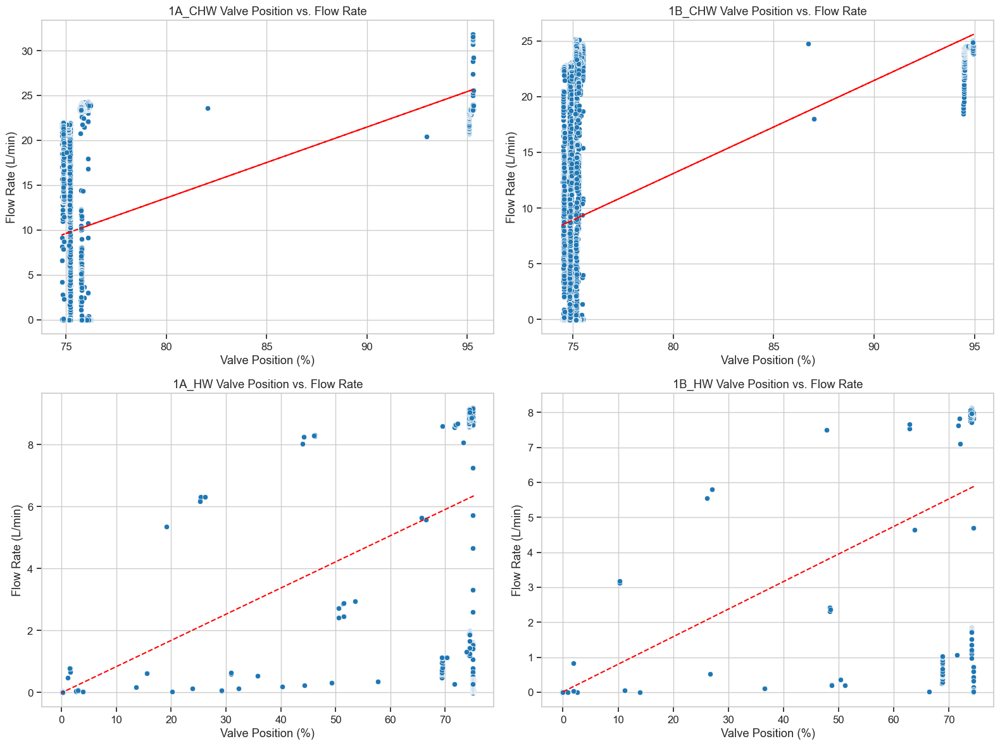

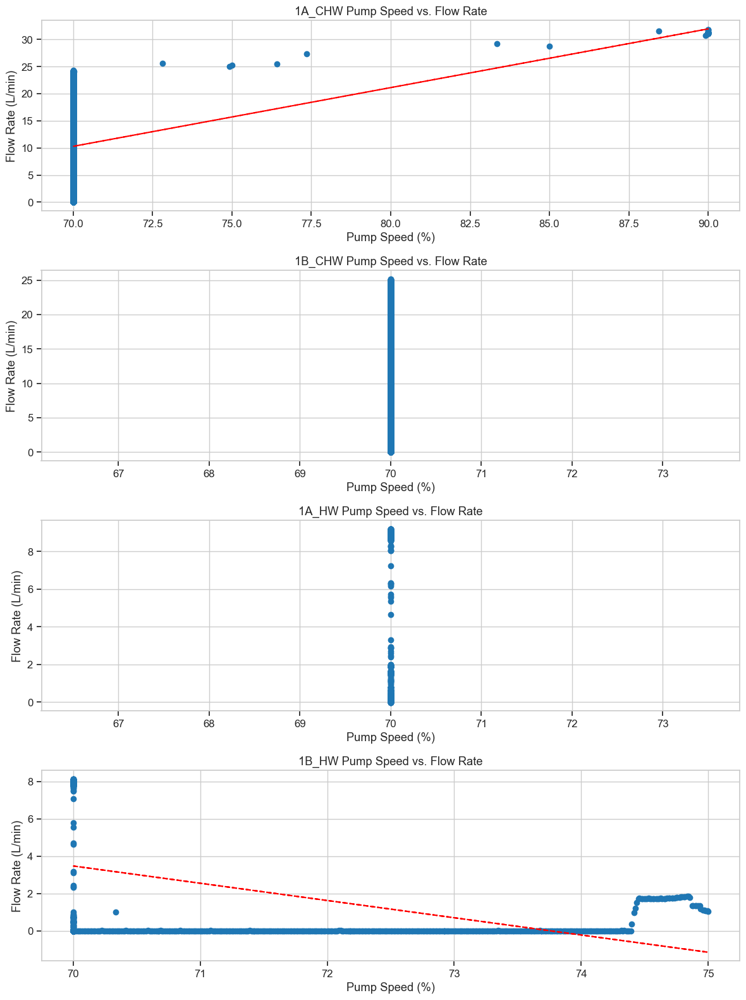

Control System Response Analysis:

1A_CHW Control Analysis:
  Valve-Flow Correlation: 0.260
  Valve Sensitivity: 1.552 L/min per % valve opening
  Control Quality: Poor
  Potential Issues:
   - Valve may have poor authority or be undersized
   - Flow sensor calibration may be incorrect
   - Control loop tuning parameters may need adjustment

1B_CHW Control Analysis:
  Valve-Flow Correlation: 0.270
  Valve Sensitivity: 1.229 L/min per % valve opening
  Control Quality: Poor
  Potential Issues:
   - Valve may have poor authority or be undersized
   - Flow sensor calibration may be incorrect
   - Control loop tuning parameters may need adjustment

1A_HW Control Analysis:
  Valve-Flow Correlation: 0.739
  Valve Sensitivity: 0.123 L/min per % valve opening
  Control Quality: Good

1B_HW Control Analysis:
  Valve-Flow Correlation: 0.741
  Valve Sensitivity: 0.109 L/min per % valve opening
  Control Quality: Good


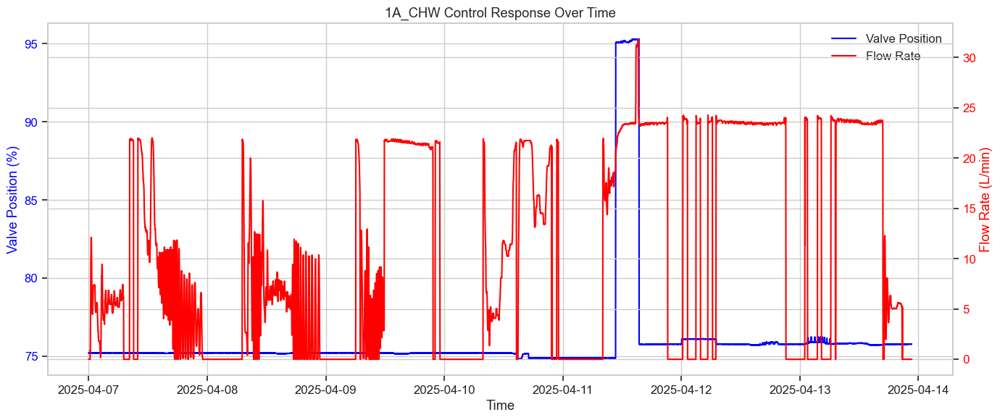

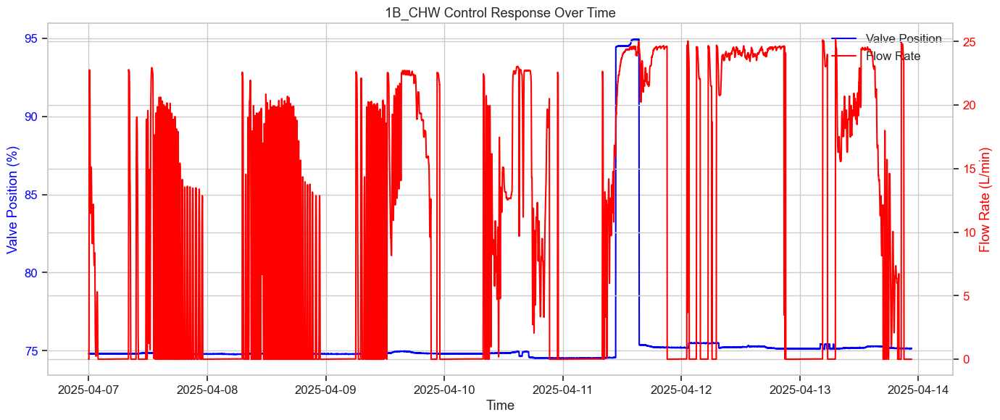

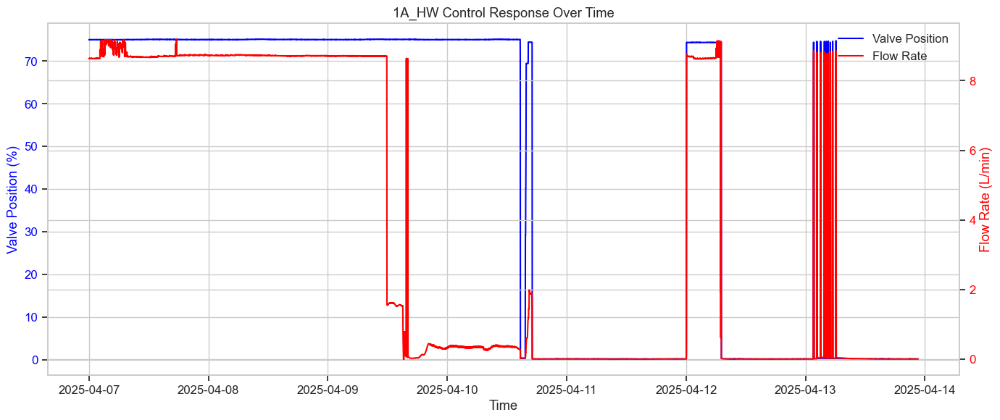

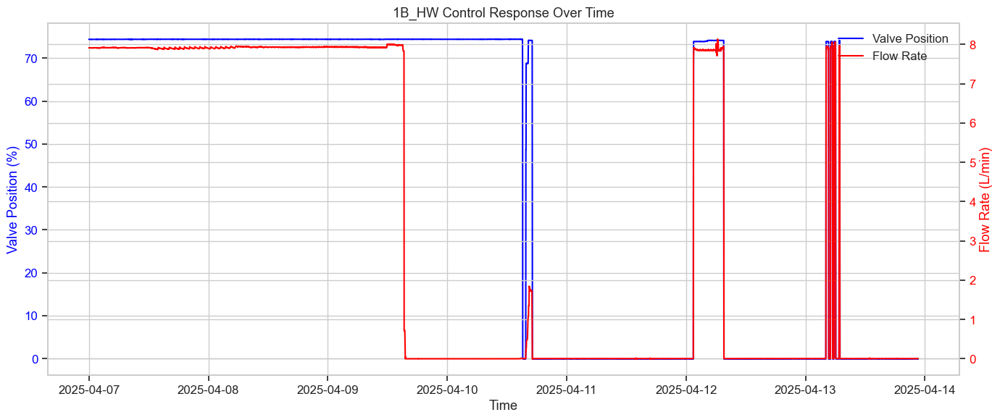

In [23]:
# Analyze system control response
def analyze_control_response(df):
    # 1. Valve position vs. Flow rate analysis for all systems
    systems = ['1A_CHW', '1B_CHW', '1A_HW', '1B_HW']
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()
    
    for i, system in enumerate(systems):
        if f'{system}_ValvePosition' in df.columns and f'{system}_FlowRate' in df.columns:
            sns.scatterplot(
                x=df[f'{system}_ValvePosition'], 
                y=df[f'{system}_FlowRate'],
                ax=axes[i]
            )
            
            # Add a trendline if there's enough data
            if len(df) > 2:
                try:
                    m, b = np.polyfit(df[f'{system}_ValvePosition'], df[f'{system}_FlowRate'], 1)
                    axes[i].plot(df[f'{system}_ValvePosition'], m*df[f'{system}_ValvePosition'] + b, 'r--')
                except:
                    pass  # In case of fitting error
            
            axes[i].set_title(f'{system} Valve Position vs. Flow Rate')
            axes[i].set_xlabel('Valve Position (%)')
            axes[i].set_ylabel('Flow Rate (L/min)')
            axes[i].grid(True)
    
    plt.tight_layout()
    plt.show()
    
    # 2. Analyze pump speed vs flow rate relationship
    pump_systems = [s for s in systems if f'{s}_PumpSpeed' in df.columns and f'{s}_FlowRate' in df.columns]
    
    if pump_systems:
        fig, axes = plt.subplots(len(pump_systems), 1, figsize=(12, 4*len(pump_systems)))
        if len(pump_systems) == 1:
            axes = [axes]
        
        for i, system in enumerate(pump_systems):
            axes[i].scatter(df[f'{system}_PumpSpeed'], df[f'{system}_FlowRate'])
            axes[i].set_title(f'{system} Pump Speed vs. Flow Rate')
            axes[i].set_xlabel('Pump Speed (%)')
            axes[i].set_ylabel('Flow Rate (L/min)')
            axes[i].grid(True)
            
            # Add trendline if possible
            if len(df) > 2:
                try:
                    m, b = np.polyfit(df[f'{system}_PumpSpeed'], df[f'{system}_FlowRate'], 1)
                    axes[i].plot(df[f'{system}_PumpSpeed'], m*df[f'{system}_PumpSpeed'] + b, 'r--')
                except:
                    pass
        
        plt.tight_layout()
        plt.show()
    
    # 3. Calculate control responsiveness metrics
    print("Control System Response Analysis:")
    
    for system in systems:
        valve_col = f'{system}_ValvePosition'
        flow_col = f'{system}_FlowRate'
        
        if valve_col in df.columns and flow_col in df.columns:
            # Calculate correlation coefficient
            correlation = df[[valve_col, flow_col]].corr().iloc[0, 1]
            
            # Calculate valve authority (simplified approach)
            # Valve authority is related to how effectively the valve controls flow
            min_flow = df[flow_col].min()
            max_flow = df[flow_col].max()
            min_valve = df[valve_col].min()
            max_valve = df[valve_col].max()
            
            valve_range = max_valve - min_valve
            flow_range = max_flow - min_flow
            
            # Valve sensitivity - change in flow per % change in valve position
            if valve_range > 0:
                valve_sensitivity = flow_range / valve_range
            else:
                valve_sensitivity = 0
            
            print(f"\n{system} Control Analysis:")
            print(f"  Valve-Flow Correlation: {correlation:.3f}")
            print(f"  Valve Sensitivity: {valve_sensitivity:.3f} L/min per % valve opening")
            
            # Classify control quality
            if abs(correlation) > 0.9:
                control_quality = "Excellent"
            elif abs(correlation) > 0.7:
                control_quality = "Good"
            elif abs(correlation) > 0.5:
                control_quality = "Fair"
            else:
                control_quality = "Poor"
            
            print(f"  Control Quality: {control_quality}")
            
            # Analysis of potential issues
            if correlation < 0.5:
                print("  Potential Issues:")
                print("   - Valve may have poor authority or be undersized")
                print("   - Flow sensor calibration may be incorrect")
                print("   - Control loop tuning parameters may need adjustment")
    
    # 4. Time-series analysis of control response
    for system in systems:
        valve_col = f'{system}_ValvePosition'
        flow_col = f'{system}_FlowRate'
        
        if valve_col in df.columns and flow_col in df.columns:
            plt.figure(figsize=(14, 6))
            
            # Primary Y-axis for valve position
            ax1 = plt.gca()
            ax1.plot(df.index, df[valve_col], 'b-', label='Valve Position')
            ax1.set_xlabel('Time')
            ax1.set_ylabel('Valve Position (%)', color='b')
            ax1.tick_params(axis='y', labelcolor='b')
            
            # Secondary Y-axis for flow rate
            ax2 = ax1.twinx()
            ax2.plot(df.index, df[flow_col], 'r-', label='Flow Rate')
            ax2.set_ylabel('Flow Rate (L/min)', color='r')
            ax2.tick_params(axis='y', labelcolor='r')
            
            # Add legends
            lines1, labels1 = ax1.get_legend_handles_labels()
            lines2, labels2 = ax2.get_legend_handles_labels()
            ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper right')
            
            plt.title(f'{system} Control Response Over Time')
            plt.grid(True)
            plt.tight_layout()
            plt.show()

# Run control analysis
analyze_control_response(df)

## 10. Multi-System Integration Analysis
Analyze how the different water systems interact with each other across the plant.

In [24]:
# Create a comprehensive summary and final recommendations
def create_summary_recommendations(df):
    # Create a summary dataframe for all key metrics
    buildings = ['1A', '1B', '1-PLT']
    system_types = ['CHW', 'HW']
    
    # Define metrics to include in summary
    metrics = [
        {'name': 'Supply Temp', 'suffix': 'SupplyTemp', 'unit': '°C', 'format': '.1f'},
        {'name': 'Return Temp', 'suffix': 'ReturnTemp', 'unit': '°C', 'format': '.1f'},
        {'name': 'Delta T', 'suffix': 'DeltaT', 'unit': '°C', 'format': '.1f'},
        {'name': 'Flow Rate', 'suffix': 'FlowRate', 'unit': 'L/min', 'format': '.2f'},
        {'name': 'Energy', 'suffix': 'Energy', 'unit': 'kW', 'format': '.2f'}
    ]
    
    # Create empty summary dataframe
    summary_index = []
    for system in system_types:
        for metric in metrics:
            summary_index.append(f"{system} {metric['name']}")
    
    summary = pd.DataFrame(index=summary_index, columns=buildings)
    
    # Fill in the summary data
    for building in buildings:
        for system in system_types:
            for metric in metrics:
                col = f"{building}_{system}_{metric['suffix']}"
                if col in df.columns:
                    value = df[col].mean()
                    idx = f"{system} {metric['name']}"
                    summary.loc[idx, building] = value
    
    # Format the summary table
    formatted_summary = summary.copy()
    for system in system_types:
        for metric in metrics:
            idx = f"{system} {metric['name']}"
            if idx in formatted_summary.index:
                for building in buildings:
                    if pd.notna(formatted_summary.loc[idx, building]):
                        formatted_summary.loc[idx, building] = f"{formatted_summary.loc[idx, building]:{metric['format']}} {metric['unit']}"
    
    print("HVAC Plant Systems Performance Summary:")
    display(formatted_summary)
    
    # Generate key findings
    print("\nKey Findings:")
    
    # 1. CHW System Findings
    print("\nChilled Water System:")
    
    # Check delta T
    chw_delta_t_cols = [col for col in df.columns if 'CHW_DeltaT' in col]
    if chw_delta_t_cols:
        avg_delta_t = sum(df[col].mean() for col in chw_delta_t_cols) / len(chw_delta_t_cols)
        if avg_delta_t < 3:
            print("  - Low delta T syndrome detected (< 3°C), indicating poor efficiency")
        elif avg_delta_t < 5:
            print("  - Below optimal delta T (< 5°C), moderate improvement potential")
        else:
            print(f"  - Good delta T performance ({avg_delta_t:.1f}°C)")
    
    # Check flow rates and valve positions
    for building in ['1A', '1B']:
        flow_col = f'{building}_CHW_FlowRate'
        valve_col = f'{building}_CHW_ValvePosition'
        
        if flow_col in df.columns and valve_col in df.columns:
            avg_flow = df[flow_col].mean()
            avg_valve = df[valve_col].mean()
            
            if avg_valve > 90 and avg_flow < 1:
                print(f"  - {building} CHW valve nearly fully open but minimal flow detected - potential blockage")
            elif avg_valve < 10 and avg_flow > 1:
                print(f"  - {building} CHW valve nearly closed with significant flow - potential valve leakage")
    
    # 2. HW System Findings
    print("\nHot Water System:")
    
    # Check delta T
    hw_delta_t_cols = [col for col in df.columns if 'HW_DeltaT' in col]
    if hw_delta_t_cols:
        avg_delta_t = sum(df[col].mean() for col in hw_delta_t_cols) / len(hw_delta_t_cols)
        if avg_delta_t < 8:
            print("  - Low delta T (< 8°C), indicating poor efficiency")
        elif avg_delta_t < 12:
            print("  - Below optimal delta T (< 12°C), moderate improvement potential")
        else:
            print(f"  - Good delta T performance ({avg_delta_t:.1f}°C)")
    
    # Check supply temperatures
    hw_supply_cols = [col for col in df.columns if 'HW_SupplyTemp' in col]
    if hw_supply_cols:
        avg_supply = sum(df[col].mean() for col in hw_supply_cols) / len(hw_supply_cols)
        if avg_supply > 65:
            print(f"  - High supply temperature ({avg_supply:.1f}°C) - energy savings potential through temperature reset")
    
    # 3. Distribution System Findings
    if '1-PLT_CHW_SupplyTemp' in df.columns:
        for building in ['1A', '1B']:
            if f'{building}_CHW_SupplyTemp' in df.columns:
                temp_rise = df[f'{building}_CHW_SupplyTemp'].mean() - df['1-PLT_CHW_SupplyTemp'].mean()
                if temp_rise > 1:
                    print(f"  - Significant temperature rise ({temp_rise:.1f}°C) in CHW distribution to {building}")
    
    if '1-PLT_HW_SupplyTemp' in df.columns:
        for building in ['1A', '1B']:
            if f'{building}_HW_SupplyTemp' in df.columns:
                temp_drop = df['1-PLT_HW_SupplyTemp'].mean() - df[f'{building}_HW_SupplyTemp'].mean()
                if temp_drop > 2:
                    print(f"  - Significant temperature drop ({temp_drop:.1f}°C) in HW distribution to {building}")
    
    # 4. Final Recommendations
    print("\nRecommendations for System Improvements:")
    
    # Check for specific issues and provide targeted recommendations
    # CHW recommendations
    chw_issues = False
    for building in ['1A', '1B']:
        chw_delta_col = f'{building}_CHW_DeltaT'
        if chw_delta_col in df.columns and df[chw_delta_col].mean() < 5:
            if not chw_issues:
                print("\nChilled Water System Recommendations:")
                chw_issues = True
            print(f"  1. Optimize {building} AHU coil control to increase CHW delta T:")
            print("     - Verify proper valve modulation across the load range")
            print("     - Consider increasing supply air temperature setpoints if comfort permits")
            print("     - Implement coil cleaning program to improve heat transfer")
    
    # HW recommendations
    hw_issues = False
    for building in ['1A', '1B']:
        hw_delta_col = f'{building}_HW_DeltaT'
        if hw_delta_col in df.columns and df[hw_delta_col].mean() < 12:
            if not hw_issues:
                print("\nHot Water System Recommendations:")
                hw_issues = True
            print(f"  1. Improve {building} HW system performance:")
            print("     - Implement outdoor air temperature reset strategy for supply temperature")
            print("     - Check for proper terminal unit valve operation and sizing")
            print("     - Verify system flow balance and consider adjusting balancing valves")
    
    # General plant recommendations
    print("\nGeneral Plant Recommendations:")
    print("  1. Implement continuous monitoring of key performance indicators:")
    print("     - Delta T for all systems")
    print("     - Control valve operation and correlation with flow")
    print("     - Distribution losses between plant and buildings")
    print("  2. Conduct regular maintenance:")
    print("     - Calibrate sensors for temperature and flow")
    print("     - Inspect control valves for proper operation")
    print("     - Clean heat exchangers and check water treatment") 
    print("  3. Optimize control sequences:")
    print("     - Implement reset strategies based on load conditions")
    print("     - Review and tune PID loops for stable control")
    print("     - Consider advanced control strategies like adaptive reset")

# Generate summary and recommendations
create_summary_recommendations(df)

HVAC Plant Systems Performance Summary:


,1A,1B,1-PLT
CHW Supply Temp,9.9 °C,8.8 °C,11.3 °C
CHW Return Temp,12.4 °C,11.5 °C,10.9 °C
CHW Delta T,2.6 °C,2.7 °C,-0.4 °C
CHW Flow Rate,10.35 L/min,9.35 L/min,30.54 L/min
CHW Energy,1.71 kW,1.91 kW,1.18 kW
HW Supply Temp,38.4 °C,38.4 °C,52.1 °C
HW Return Temp,36.1 °C,36.9 °C,53.2 °C
HW Delta T,2.3 °C,1.5 °C,-1.1 °C
HW Flow Rate,3.63 L/min,3.38 L/min,NaN
HW Energy,0.64 kW,0.72 kW,NaN



Key Findings:

Chilled Water System:
  - Low delta T syndrome detected (< 3°C), indicating poor efficiency

Hot Water System:
  - Low delta T (< 8°C), indicating poor efficiency
  - Significant temperature drop (13.7°C) in HW distribution to 1A
  - Significant temperature drop (13.7°C) in HW distribution to 1B

Recommendations for System Improvements:

Chilled Water System Recommendations:
  1. Optimize 1A AHU coil control to increase CHW delta T:
     - Verify proper valve modulation across the load range
     - Consider increasing supply air temperature setpoints if comfort permits
     - Implement coil cleaning program to improve heat transfer
  1. Optimize 1B AHU coil control to increase CHW delta T:
     - Verify proper valve modulation across the load range
     - Consider increasing supply air temperature setpoints if comfort permits
     - Implement coil cleaning program to improve heat transfer

Hot Water System Recommendations:
  1. Improve 1A HW system performance:
     - I